## Imports

In [1]:
import QuantumToolbox as qt
using Logging
import CairoMakie as cm
using DifferentialEquations
using MiniLoggers
using ProgressMeter
using LoggingExtras
using Revise
using Dates
using YAXArrays
using DimensionalData

using LinearAlgebra
import LsqFit as LF

import Peaks
using Zygote

using JSON3

In [2]:
import SuperconductingCavities as SC

┌ Info: new driver key :netcdf, updating backendlist.
└ @ NetCDFExt /home/gr400/.julia/packages/YAXArrayBase/Xj43k/ext/NetCDFExt.jl:81


## Logger Setups

In [3]:
# MiniLogger(minlevel = MiniLoggers.Info) |> global_logger
InfoLogger = MiniLogger(minlevel = MiniLoggers.Info)
ProgressLogger = MiniLogger(minlevel = LogLevel(-1))
DebugLogger = MiniLogger(minlevel = MiniLoggers.Debug)

global_logger(InfoLogger)

Base.CoreLogging.SimpleLogger(VSCodeServer.IJuliaCore.IJuliaStdio{Base.PipeEndpoint, typeof(VSCodeServer.io_send_callback)}(IOContext(Base.PipeEndpoint(RawFD(21) open, 0 bytes waiting)), VSCodeServer.io_send_callback), Info, Dict{Any, Int64}())

# Mode 3

In [4]:
Mode3 = SC.Circuits.Transmon_Resonators.load("ModelSaves/Mode3/Mode3.json");

In [5]:
Mode3.Stuff["op_drive_params"]["sb_f0g1"]

Dict{String, Any} with 7 entries:
  "pulse_time"    => 205.054
  "Envelope Args" => Dict{String, Any}("pulse_time"=>205.054, "k"=>2, "ramp_tim…
  "epsilon"       => 0.735
  "Envelope"      => "Bump_Ramp"
  "shift"         => 0.0376647
  "accuracy"      => 0.999605
  "freq_d"        => -2.86996

## Error Budget Plot (Bare Loss Ops)

### Loading Data

In [ ]:
push!(collect(keys(Mode3.CandD_Ops)), "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")

In [ ]:
init_states = ["g0", "e0", "g0_p_e0", "g0_m_e0", "g0_p_ie0", "g0_m_ie0"]
losses = push!(collect(keys(Mode3.CandD_Ops)), "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")
losses = push!(losses, "")

itert = Iterators.product(init_states, losses)

Mode3ErrorBudgetBare = Dict{Any, Any}()

order = ["Step_1", "Step_2", "Step_3", "Step_4", "Step_5", "Step_6", "Step_7", "Step_8", "Step_9", "Step_10", "Step_11", "Step_12", "Step_13", "Step_14", "Step_15", "Step_16", "Step_17", "Step_18"]

the_path = "Data/Binomial_Encoding_Sun-Oct-13-24:18:2/data/"

for combo in itert
    file_name = the_path*combo[1]*"_"*combo[2]*".nc"
    if combo[2] == ""
        file_name = the_path*combo[1]*".nc"
    end
    @info file_name
    Mode3ErrorBudgetBare[combo] = SC.Utils.LoadRunResults(file_name, cube_order = order, h_dims = [10,10])
end


In [ ]:
state_dict = Dict{Any, Any}()
for state in collect(Iterators.product([0,1,2], [0,1,2,3,4]))
    state_dict[state] = Mode3.dressed_states[state]
end

Projection_Ops = SC.Utils.Get_Projection_Ops(state_dict)

Probabilities = Dict{Any, Any}()
for key in keys(Mode3ErrorBudgetBare)
    @info "On $key"
    Probabilities[key] = SC.Utils.Get_EVs(Mode3ErrorBudgetBare[key]["states"], Projection_Ops)
end

In [ ]:
Probabilities[("g0", "Bare Mode 3 Collapse_Bare Transmon Collapse_Bare Transmon Dephasing")][(0,2)][end]

### Plotting All State Evolutions

In [ ]:
for key in keys(Mode3ErrorBudgetBare)
    axis_kwargs = Dict{Any, Any}("title" => string(key))
    SC.Dynamics.PlotSingleModeEvolution(Mode3, Mode3ErrorBudgetBare[key]["times"], Probabilities[key], axis_kwargs = axis_kwargs)
end

##  Prepairing $|n\rangle$

### $|1\rangle$ 

#### Running No Loss

In [12]:
ψ = Mode3.dressed_states[(0,0)]

prep_1_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_1"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.14.21
It is being saved at: Data/
[2024-11-14 14:21:54] Info: Running operator q_ge_0
[2024-11-14 14:21:54] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)
[2024-11-14 14:21:58] Info: Time Evolution Complete
[2024-11-14 14:21:58] Info: Saving Steps
[2024-11-14 14:21:59] Info: Done with Step_1
[2024-11-14 14:21:59] Info: Running operator q_ef_0
[2024-11-14 14:21:59] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:22:02] Info: Time Evolution Complete
[2024-11-14 14:22:02] Info: Saving Steps
[2024-11-14 14:22:03] Info: Done with Step_2
[2024-11-14 14:22:03] Info: Running operator sb_f0g1
[2024-11-14 14:22:03] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 07s (ETA: 0h 00m 00s)
[2024-11-14 14:22:11] Info: Tim

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [150]:
EVs_1 = SC.Utils.Get_EVs(prep_1_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [151]:
real(EVs_1[(0,1)][end])

0.9988652927946838

[2024-11-14 14:50:12] Info: Making Plot


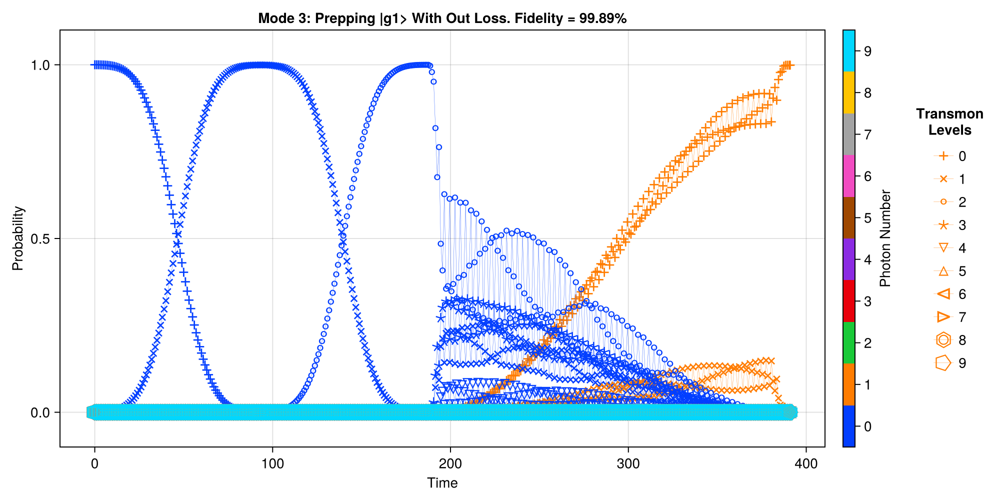

CairoMakie.Screen{IMAGE}


In [108]:
fid = round(real(EVs_1[(0,1)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g1> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_1_res["times"], EVs_1, axis_kwargs = axis_kwargs, plot_every = 5)

In [54]:
println("Fidelity: $(EVs_1[(0,1)][end])")

Fidelity: 0.9988652927946838 - 9.522739775946182e-18im


#### Looking at With Loss

In [18]:
prep_1_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_1_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:03


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [55]:
EVs_1_loss = SC.Utils.Get_EVs(prep_1_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [143]:
real(EVs_1_loss[(0,1)][end])

0.9907214355470519

[2024-11-14 14:46:30] Info: Making Plot


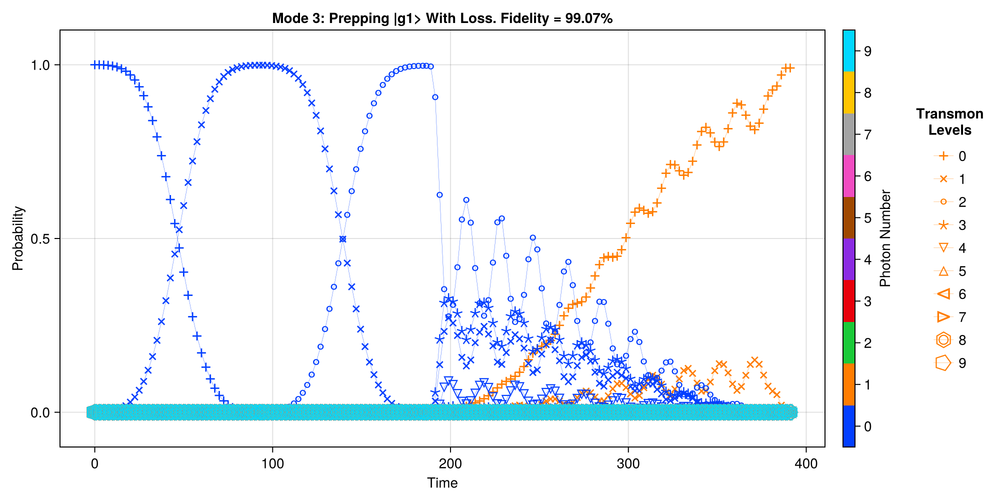

CairoMakie.Screen{IMAGE}


In [105]:
fid = round(real(EVs_1_loss[(0,1)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g1> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_1_loss["times"], EVs_1_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [57]:
println("Fidelity: $(EVs_1_loss[(0,1)][end])")

Fidelity: 0.9907214355470519 - 1.337187480272783e-15im


#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [193]:
prep_1_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_1_Wed-Nov-13-24_18_27.nc")
prep_1_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_1_upper_Thu-Nov-14-24_18_10.nc")
prep_1_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_1_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00
Progress: 100%|█████████████████████████████████████████| Time: 0:00:01
Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [194]:
EVs_1_loss = SC.Utils.Get_EVs(prep_1_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_1_loss_upper = SC.Utils.Get_EVs(prep_1_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_1_loss_lower = SC.Utils.Get_EVs(prep_1_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9907214355470519
[2024-11-15 17:21:49] Info: Making Plot
Fidelity: 0.9812566679003847
[2024-11-15 17:21:50] Info: Making Plot
Fidelity: 0.9724199858647432
[2024-11-15 17:21:51] Info: Making Plot


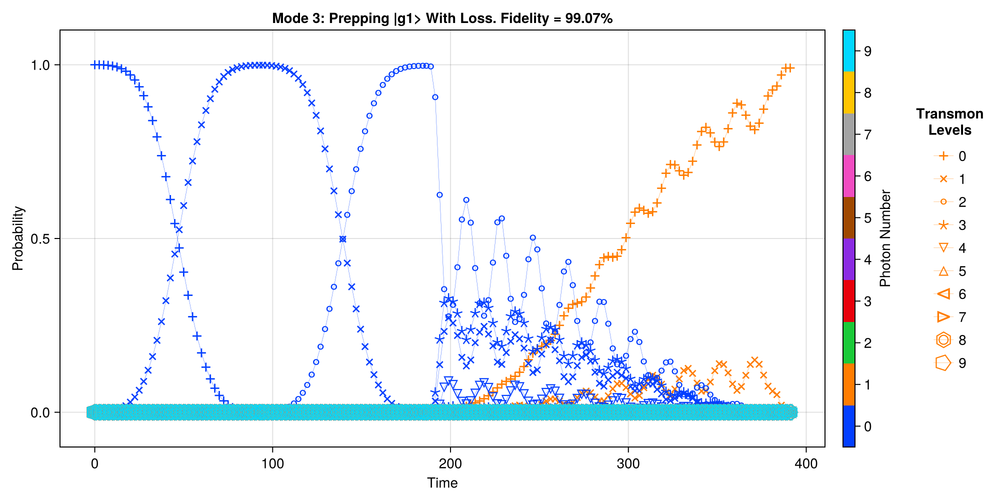

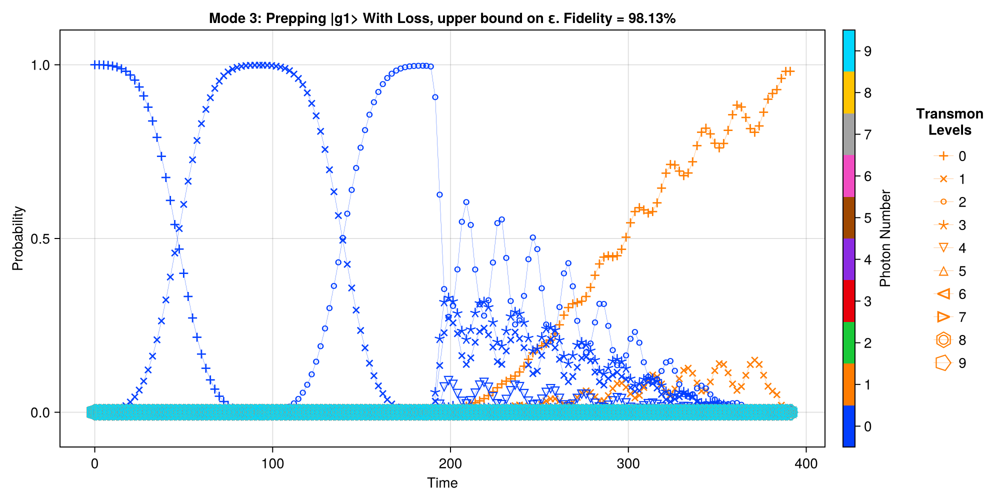

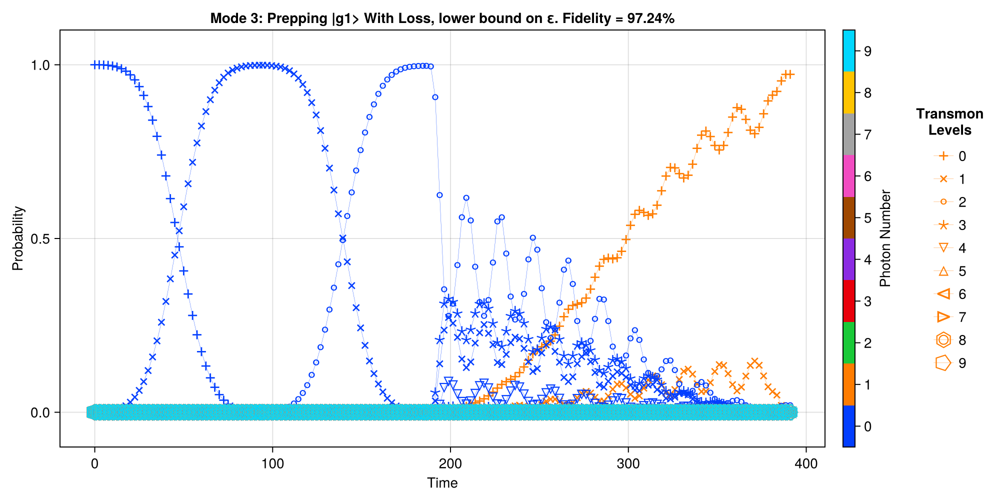

CairoMakie.Screen{IMAGE}


In [197]:
fid = real(EVs_1_loss[(0,1)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g1> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_1_loss["times"], EVs_1_loss, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_1_loss_upper[(0,1)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g1> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_1_loss_upper["times"], EVs_1_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_1_loss_lower[(0,1)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g1> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_1_loss_upper["times"], EVs_1_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|2\rangle$ 

#### Running No Loss

In [23]:
ψ = Mode3.dressed_states[(0,0)]

prep_2_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_2"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.14.26
It is being saved at: Data/
[2024-11-14 14:26:41] Info: Running operator q_ge_0
[2024-11-14 14:26:41] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)
[2024-11-14 14:26:44] Info: Time Evolution Complete
[2024-11-14 14:26:44] Info: Saving Steps
[2024-11-14 14:26:46] Info: Done with Step_1
[2024-11-14 14:26:46] Info: Running operator q_ef_0
[2024-11-14 14:26:46] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:26:49] Info: Time Evolution Complete
[2024-11-14 14:26:49] Info: Saving Steps
[2024-11-14 14:26:50] Info: Done with Step_2
[2024-11-14 14:26:50] Info: Running operator sb_f0g1
[2024-11-14 14:26:50] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 06s (ETA: 0h 00m 00s)
[2024-11-14 14:26:56] Info: Tim

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [58]:
EVs_2 = SC.Utils.Get_EVs(prep_2_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [144]:
real(EVs_2[(0,2)][end])

0.9972580564385812

[2024-11-14 14:46:47] Info: Making Plot


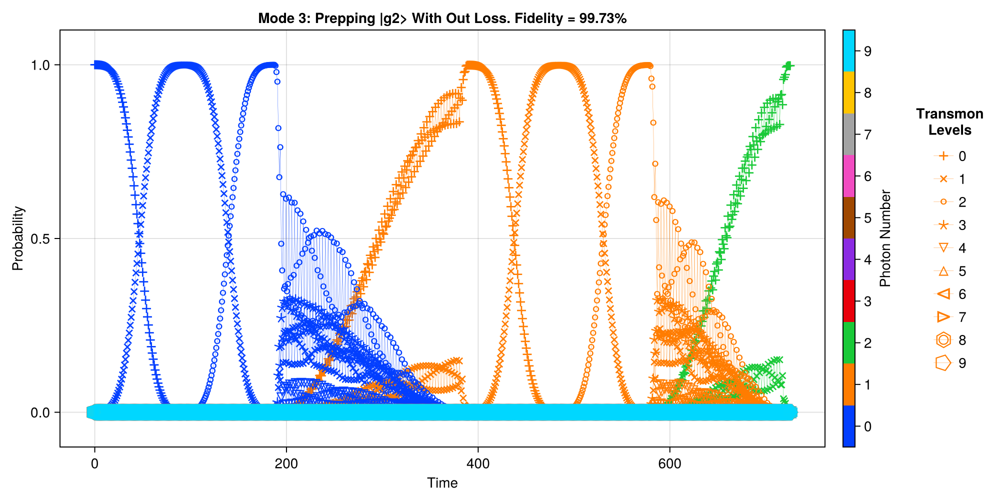

CairoMakie.Screen{IMAGE}


In [107]:
fid = round(real(EVs_2[(0,2)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g2> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_2_res["times"], EVs_2, axis_kwargs = axis_kwargs, plot_every = 5)

In [61]:
println("Fidelity: $(EVs_2[(0,2)][end])")

Fidelity: 0.9972580564385812 - 9.422215301456457e-18im


#### Looking at With Loss

In [25]:
prep_2_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_2_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [62]:
EVs_2_loss = SC.Utils.Get_EVs(prep_2_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [145]:
real(EVs_2_loss[(0,2)][end])

0.9818664924338543

[2024-11-14 14:44:55] Info: Making Plot


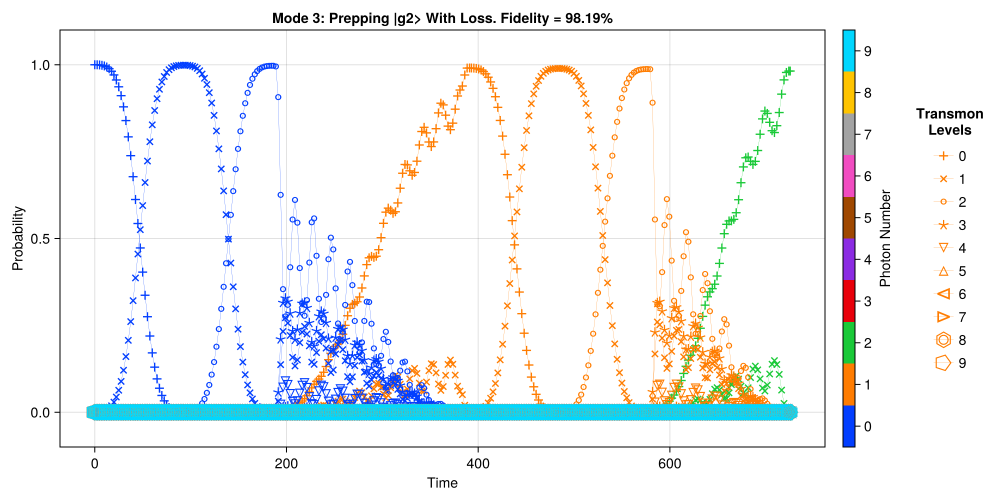

CairoMakie.Screen{IMAGE}


In [101]:
fid = round(real(EVs_2_loss[(0,2)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g2> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_2_loss["times"], EVs_2_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [64]:
println("Fidelity: $(EVs_2_loss[(0,2)][end])")

Fidelity: 0.9818664924338543 - 2.5755960543362334e-16im


#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [198]:
prep_2_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_2_Wed-Nov-13-24_18_27.nc")
prep_2_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_2_upper_Thu-Nov-14-24_18_10.nc")
prep_2_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_2_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02
Progress: 100%|█████████████████████████████████████████| Time: 0:00:02
Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [199]:
EVs_2_loss = SC.Utils.Get_EVs(prep_2_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_2_loss_upper = SC.Utils.Get_EVs(prep_2_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_2_loss_lower = SC.Utils.Get_EVs(prep_2_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9818664924338543
[2024-11-15 17:24:58] Info: Making Plot
Fidelity: 0.9712571287334049
[2024-11-15 17:25:00] Info: Making Plot
Fidelity: 0.9513535956474136
[2024-11-15 17:25:03] Info: Making Plot


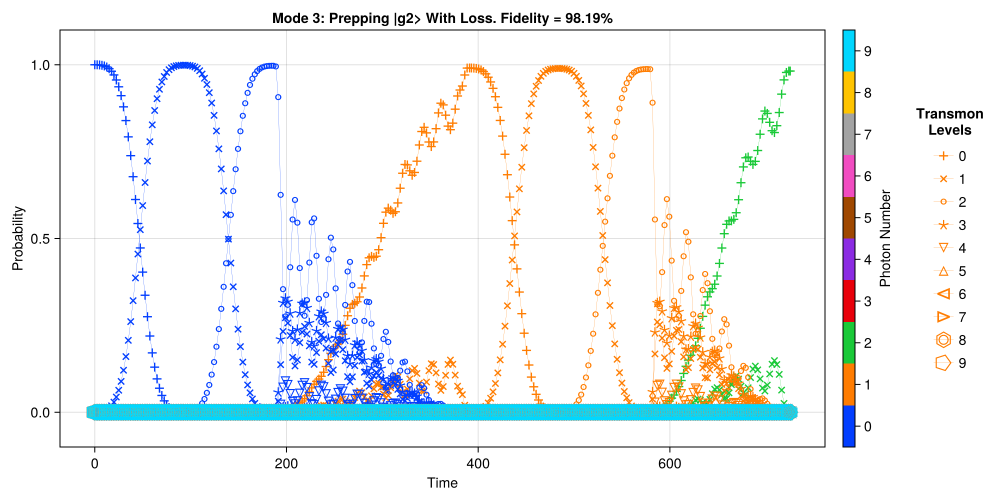

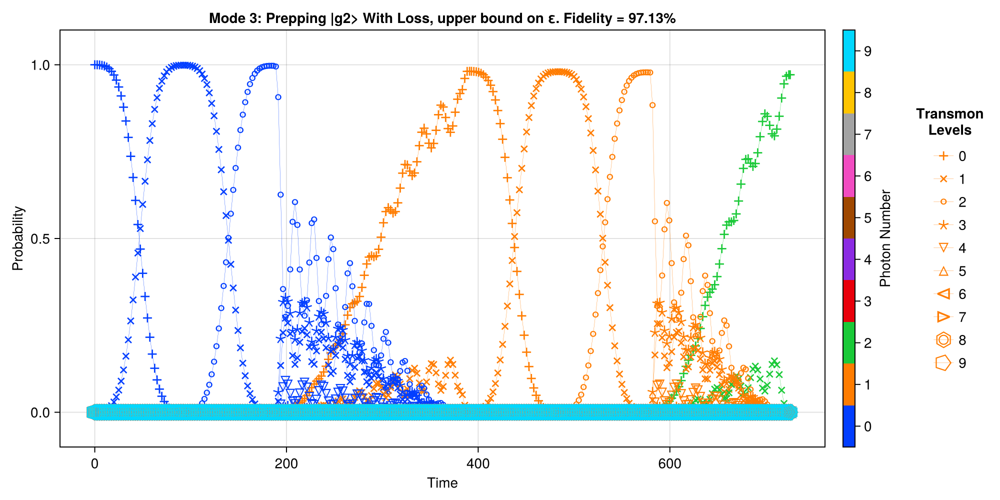

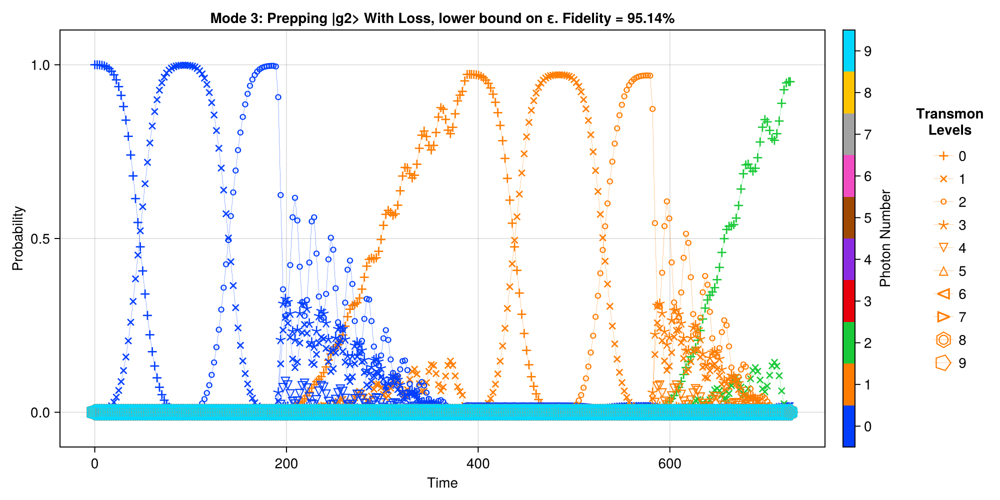

CairoMakie.Screen{IMAGE}


In [201]:
fid = real(EVs_2_loss[(0,2)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g2> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_2_loss["times"], EVs_2_loss, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_2_loss_upper[(0,2)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g2> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_2_loss_upper["times"], EVs_2_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_2_loss_lower[(0,2)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g2> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_2_loss_upper["times"], EVs_2_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|3\rangle$ 

#### Running No Loss

In [44]:
ψ = Mode3.dressed_states[(0,0)]

prep_3_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_3"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.14.30
It is being saved at: Data/
[2024-11-14 14:30:59] Info: Running operator q_ge_0
[2024-11-14 14:30:59] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)
[2024-11-14 14:31:02] Info: Time Evolution Complete
[2024-11-14 14:31:02] Info: Saving Steps
[2024-11-14 14:31:04] Info: Done with Step_1
[2024-11-14 14:31:04] Info: Running operator q_ef_0
[2024-11-14 14:31:04] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)
[2024-11-14 14:31:07] Info: Time Evolution Complete
[2024-11-14 14:31:07] Info: Saving Steps
[2024-11-14 14:31:09] Info: Done with Step_2
[2024-11-14 14:31:09] Info: Running operator sb_f0g1
[2024-11-14 14:31:09] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 07s (ETA: 0h 00m 00s)
[2024-11-14 14:31:16] Info: Tim

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [45]:
EVs_3 = SC.Utils.Get_EVs(prep_3_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [146]:
real(EVs_3[(0,3)][end])

0.9947866093200116

[2024-11-14 14:44:15] Info: Making Plot


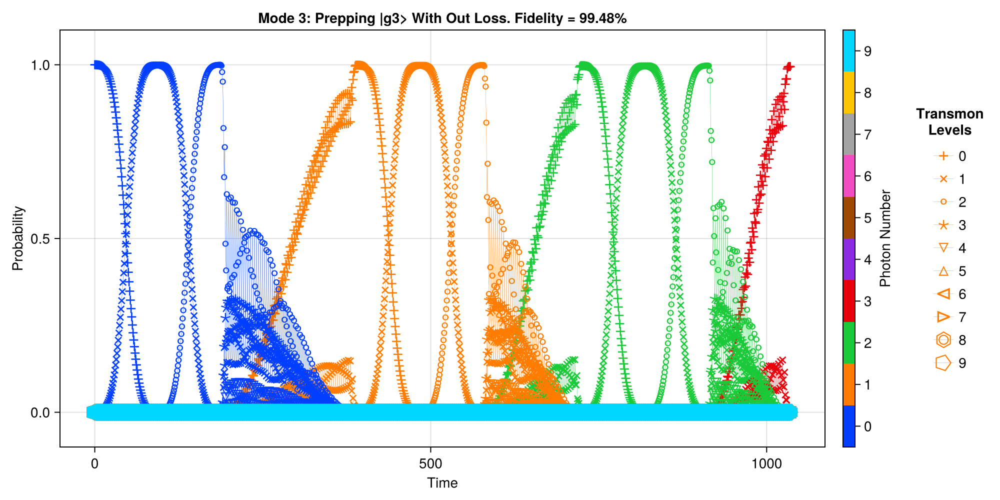

CairoMakie.Screen{IMAGE}


In [100]:
fid = round(real(EVs_3[(0,3)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g3> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_3_res["times"], EVs_3, axis_kwargs = axis_kwargs, plot_every = 5)

In [47]:
println("Fidelity: $(EVs_3[(0,3)][end])")

Fidelity: 0.9947866093200116 - 3.947525036681329e-17im


#### Looking at With Loss

In [48]:
prep_3_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_3_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:03


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [49]:
EVs_3_loss = SC.Utils.Get_EVs(prep_3_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [147]:
real(EVs_3_loss[(0,3)][end])

0.9726108905069359

[2024-11-14 14:43:30] Info: Making Plot


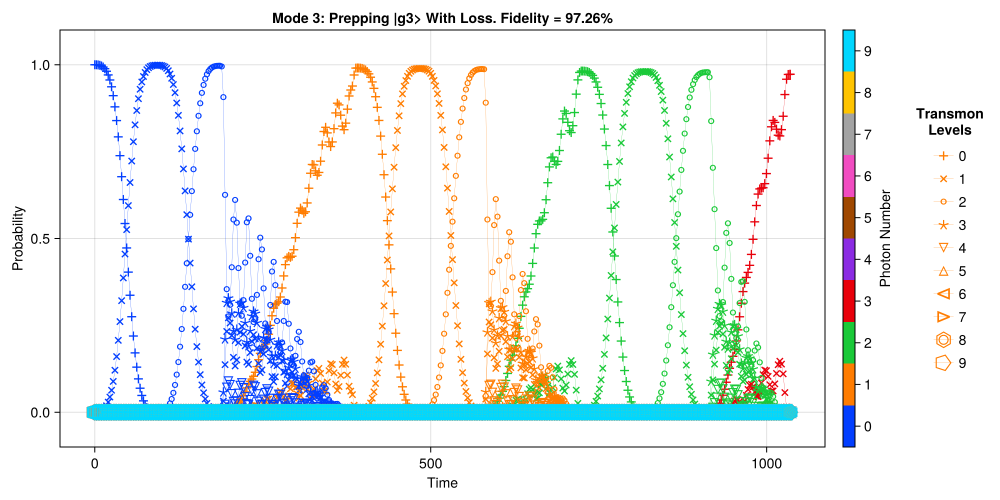

CairoMakie.Screen{IMAGE}


In [98]:
fid = round(real(EVs_3_loss[(0,3)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g3> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_3_loss["times"], EVs_3_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [51]:
println("Fidelity: $(EVs_3_loss[(0,3)][end])")

Fidelity: 0.9726108905069359 + 1.7017993304912887e-15im


#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [202]:
prep_3_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_3_Wed-Nov-13-24_18_27.nc")
prep_3_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_3_upper_Thu-Nov-14-24_18_10.nc")
prep_3_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_3_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:03
Progress: 100%|█████████████████████████████████████████| Time: 0:00:04
Progress: 100%|█████████████████████████████████████████| Time: 0:00:04


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [203]:
EVs_3_loss = SC.Utils.Get_EVs(prep_3_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_3_loss_upper = SC.Utils.Get_EVs(prep_3_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_3_loss_lower = SC.Utils.Get_EVs(prep_3_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9726108905069359
[2024-11-15 17:27:18] Info: Making Plot
Fidelity: 0.9635541880585805
[2024-11-15 17:27:21] Info: Making Plot
Fidelity: 0.9320643428188783
[2024-11-15 17:27:24] Info: Making Plot


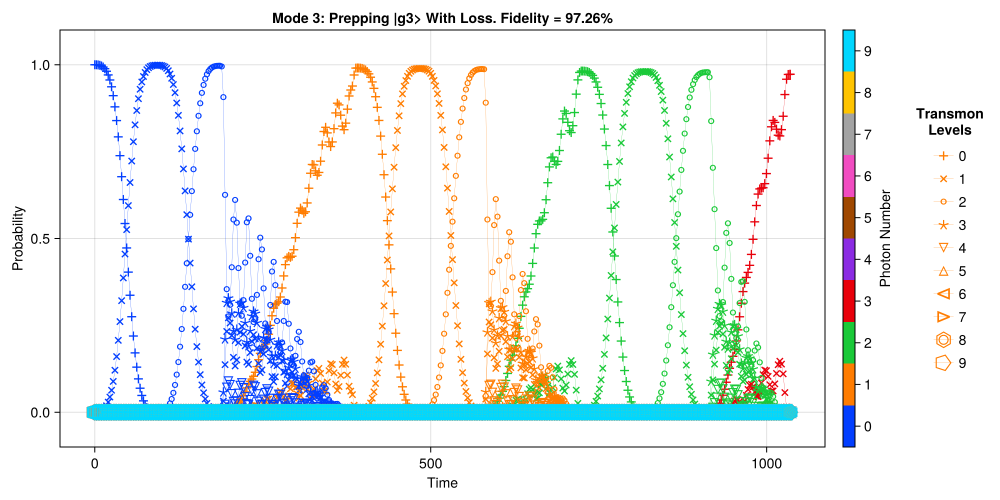

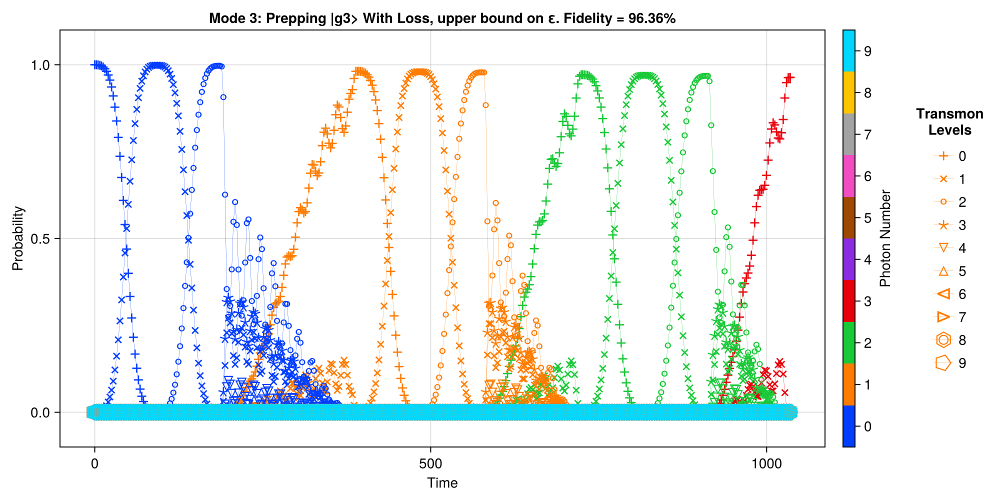

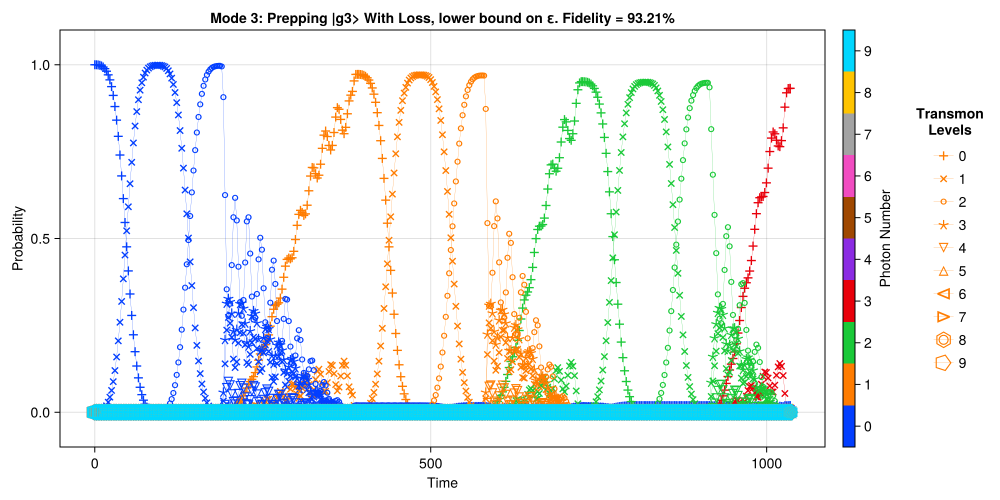

CairoMakie.Screen{IMAGE}


In [204]:
fid = real(EVs_3_loss[(0,3)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g3> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_3_loss["times"], EVs_3_loss, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_3_loss_upper[(0,3)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g3> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_3_loss_upper["times"], EVs_3_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_3_loss_lower[(0,3)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g3> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_3_loss_upper["times"], EVs_3_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|4\rangle$ 

#### Running No Loss

In [65]:
ψ = Mode3.dressed_states[(0,0)]

prep_4_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_4"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.14.34
It is being saved at: Data/
[2024-11-14 14:34:23] Info: Running operator q_ge_0
[2024-11-14 14:34:23] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:34:26] Info: Time Evolution Complete
[2024-11-14 14:34:26] Info: Saving Steps
[2024-11-14 14:34:27] Info: Done with Step_1
[2024-11-14 14:34:27] Info: Running operator q_ef_0
[2024-11-14 14:34:27] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:34:30] Info: Time Evolution Complete
[2024-11-14 14:34:30] Info: Saving Steps
[2024-11-14 14:34:31] Info: Done with Step_2
[2024-11-14 14:34:31] Info: Running operator sb_f0g1
[2024-11-14 14:34:31] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 05s (ETA: 0h 00m 00s)
[2024-11-14 14:34:36] Info: Tim

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [66]:
EVs_4 = SC.Utils.Get_EVs(prep_4_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [88]:
round(1.0, digits = 2)

1.0

In [148]:
real(EVs_4[(0,4)][end])

0.9914522659742087

[2024-11-14 14:42:01] Info: Making Plot


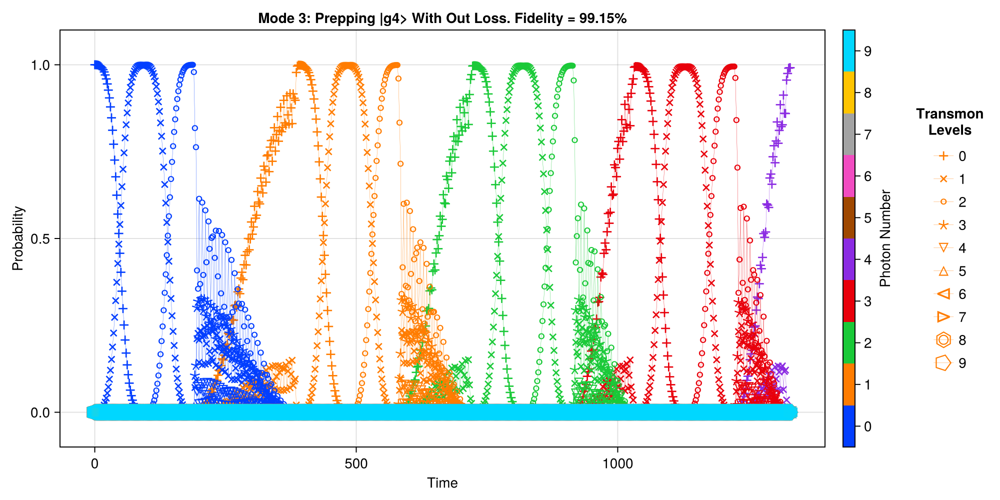

CairoMakie.Screen{IMAGE}


In [95]:
fid = round(real(EVs_4[(0,4)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g4> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_4_res["times"], EVs_4, axis_kwargs = axis_kwargs, plot_every = 10)

In [68]:
println("Fidelity: $(EVs_4[(0,4)][end])")

Fidelity: 0.9914522659742087 + 1.4657028561868912e-16im


#### Looking at With Loss

In [69]:
prep_4_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_4_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:05


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [70]:
EVs_4_loss = SC.Utils.Get_EVs(prep_4_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

In [149]:
real(EVs_4_loss[(0,4)][end])

0.9627233704116239

[2024-11-14 14:42:45] Info: Making Plot


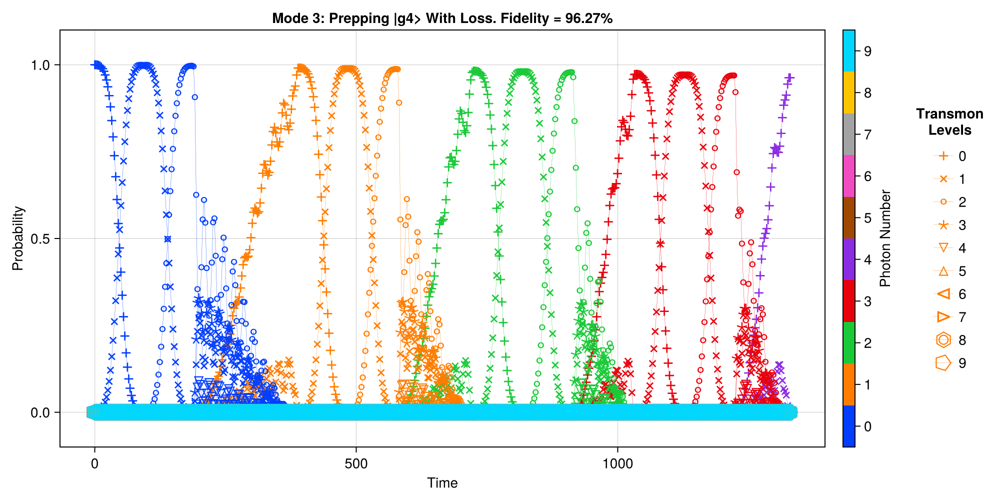

CairoMakie.Screen{IMAGE}


In [97]:
fid = round(real(EVs_4_loss[(0,4)][end])*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g4> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_4_loss["times"], EVs_4_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [72]:
println("Fidelity: $(EVs_4_loss[(0,4)][end])")

Fidelity: 0.9627233704116239 + 2.5471516025330502e-15im


#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [205]:
prep_4_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_4_Wed-Nov-13-24_18_27.nc")
prep_4_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_4_upper_Thu-Nov-14-24_18_10.nc")
prep_4_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_4_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:05
Progress: 100%|█████████████████████████████████████████| Time: 0:00:02
Progress: 100%|█████████████████████████████████████████| Time: 0:00:05


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [206]:
EVs_4_loss = SC.Utils.Get_EVs(prep_4_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_4_loss_upper = SC.Utils.Get_EVs(prep_4_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_4_loss_lower = SC.Utils.Get_EVs(prep_4_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9627233704116239
[2024-11-15 17:33:08] Info: Making Plot
Fidelity: 0.9564882034400164
[2024-11-15 17:33:12] Info: Making Plot
Fidelity: 0.9133915268514825
[2024-11-15 17:33:15] Info: Making Plot


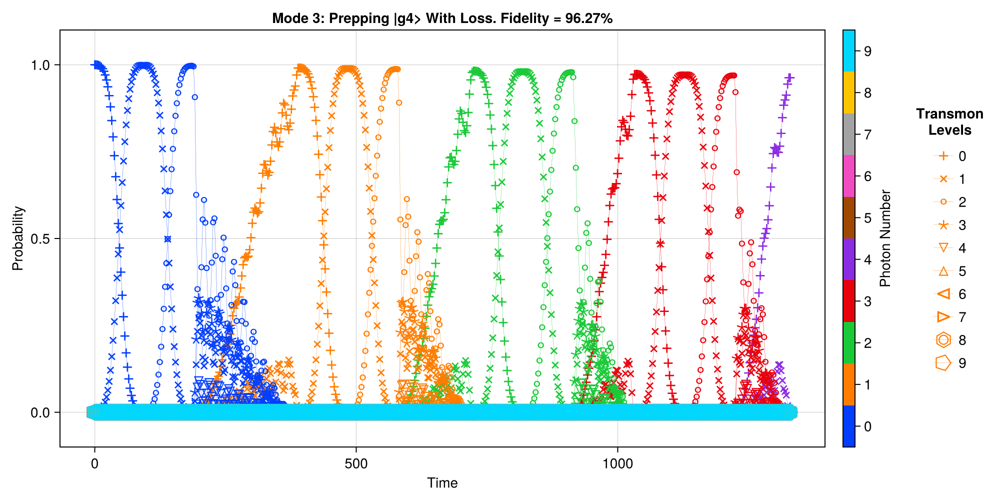

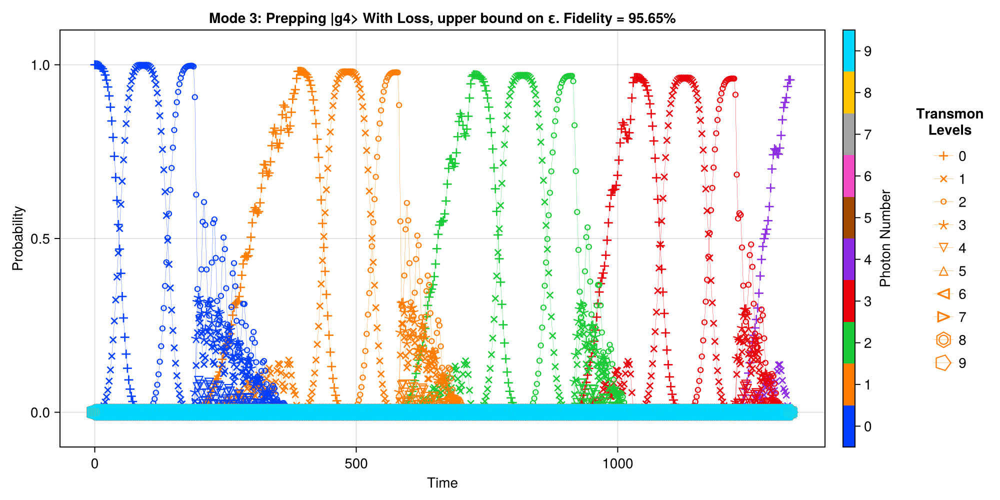

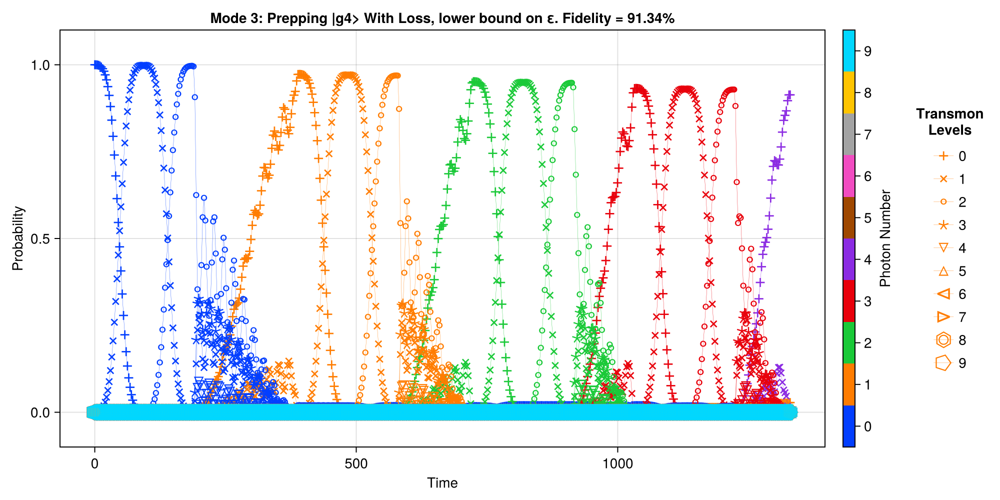

CairoMakie.Screen{IMAGE}


In [207]:
fid = real(EVs_4_loss[(0,4)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g4> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_4_loss["times"], EVs_4_loss, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_4_loss_upper[(0,4)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g4> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_4_loss_upper["times"], EVs_4_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(EVs_4_loss_lower[(0,4)][end])
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g4> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_4_loss_upper["times"], EVs_4_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


##  Prepairing $|0\rangle+|n\rangle$

### $|0\rangle+|1\rangle$ 

#### Running No Loss

In [111]:
ψ = Mode3.dressed_states[(0,0)]

prep_0p1_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_0_+_1"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.14.55
It is being saved at: Data/
[2024-11-14 14:55:36] Info: Running operator q_ge_0
[2024-11-14 14:55:36] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 03s (ETA: 0h 00m 00s)
[2024-11-14 14:55:40] Info: Time Evolution Complete
[2024-11-14 14:55:40] Info: Saving Steps
[2024-11-14 14:55:41] Info: Done with Step_1
[2024-11-14 14:55:41] Info: Running operator q_half_ef0
[2024-11-14 14:55:41] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:55:43] Info: Time Evolution Complete
[2024-11-14 14:55:43] Info: Saving Steps
[2024-11-14 14:55:45] Info: Done with Step_2
[2024-11-14 14:55:45] Info: Running operator q_ge_0
[2024-11-14 14:55:45] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 14:55:47] Info: 

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [112]:
EVs_0p1 = SC.Utils.Get_EVs(prep_0p1_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

0.9989582140173197
[2024-11-14 15:54:44] Info: Making Plot


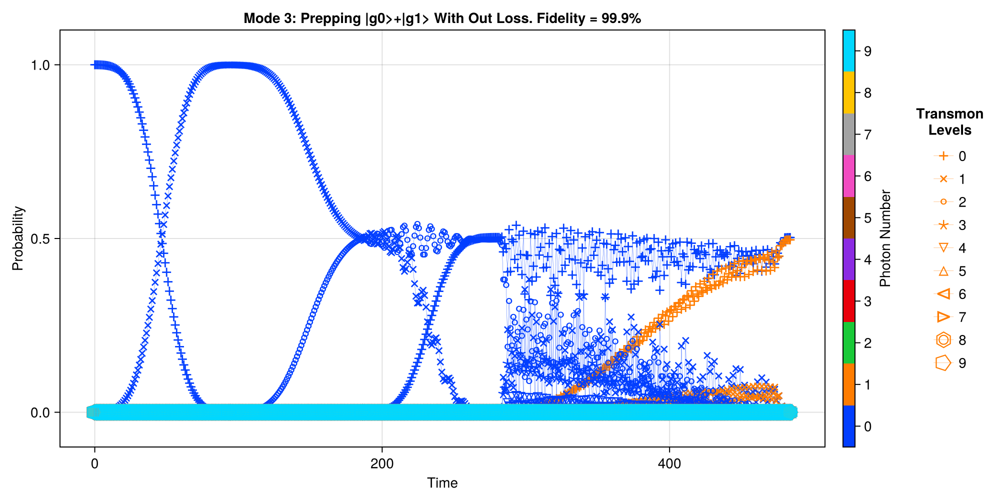

CairoMakie.Screen{IMAGE}


In [152]:
n = 1
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p1_res["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g1> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p1_res["times"], EVs_0p1, axis_kwargs = axis_kwargs, plot_every = 5)

In [154]:
real(qt.expect(op, prep_0p1_res["states"][end]))

0.9989582140173197

#### Looking at With Loss

In [120]:
prep_0p1_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_1_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [121]:
EVs_0p1_loss = SC.Utils.Get_EVs(prep_0p1_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 15:00:41] Info: Making Plot


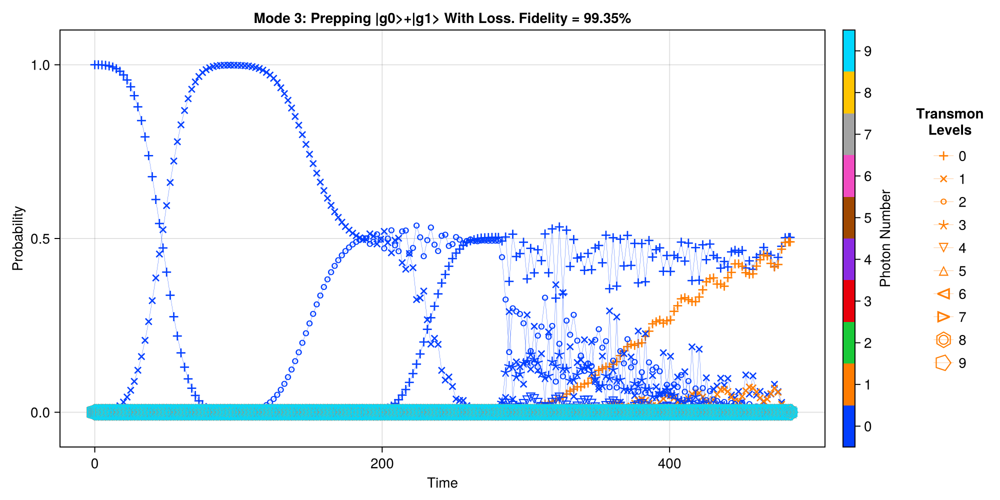

CairoMakie.Screen{IMAGE}


In [122]:
n = 1
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p1_loss["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g1> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p1_loss["times"], EVs_0p1_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [153]:
real(qt.expect(op, prep_0p1_loss["states"][end]))

0.9934595885821429

#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [208]:
prep_0p1_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_1_Wed-Nov-13-24_18_27.nc")
prep_0p1_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_1_upper_Thu-Nov-14-24_18_12.nc")
prep_0p1_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_1_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01
Progress: 100%|█████████████████████████████████████████| Time: 0:00:01
Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [209]:
EVs_0p1_loss = SC.Utils.Get_EVs(prep_0p1_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p1_loss_upper = SC.Utils.Get_EVs(prep_0p1_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p1_loss_lower = SC.Utils.Get_EVs(prep_0p1_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9934595885821429
[2024-11-15 17:40:48] Info: Making Plot
Fidelity: 0.988602066685383
[2024-11-15 17:40:49] Info: Making Plot
Fidelity: 0.9844501152593592
[2024-11-15 17:40:50] Info: Making Plot


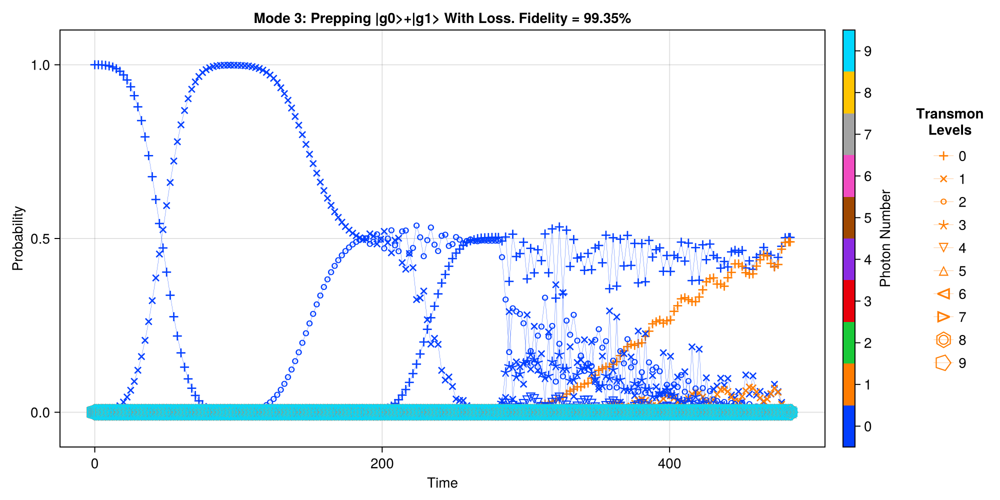

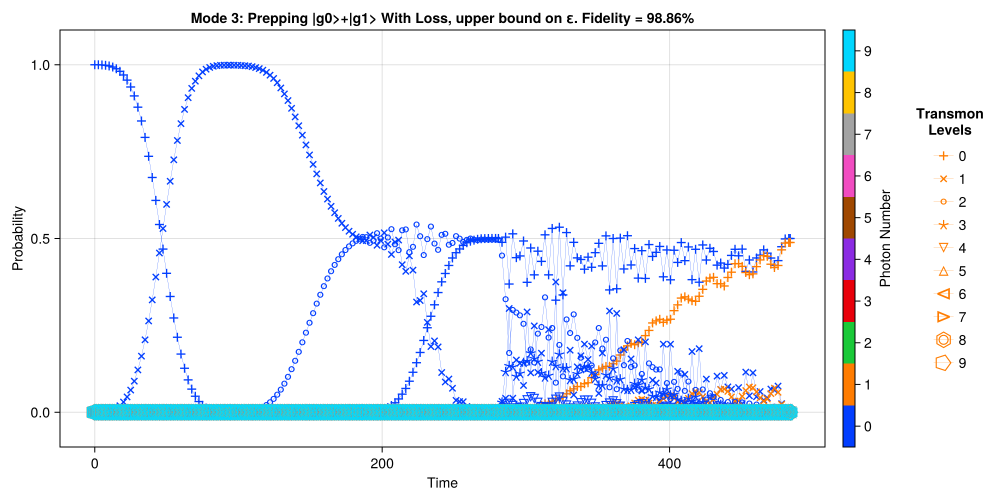

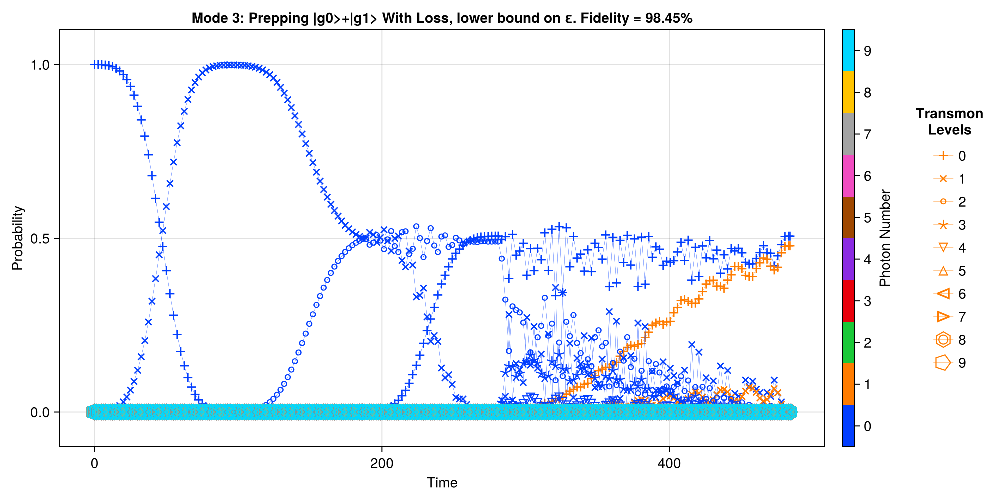

CairoMakie.Screen{IMAGE}


In [210]:
n = 1
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'

fid = real(qt.expect(op, prep_0p1_loss["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(1)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p1_loss["times"], EVs_0p1_loss, axis_kwargs = axis_kwargs, plot_every = 5)


fid = real(qt.expect(op, prep_0p1_loss_upper["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(1)> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p1_loss_upper["times"], EVs_0p1_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(qt.expect(op, prep_0p1_loss_lower["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(1)> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p1_loss_lower["times"], EVs_0p1_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|0\rangle+|2\rangle$ 

#### Running No Loss

In [123]:
ψ = Mode3.dressed_states[(0,0)]

prep_0p2_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_0_+_2"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.15.1
It is being saved at: Data/
[2024-11-14 15:01:54] Info: Running operator q_ge_0
[2024-11-14 15:01:54] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 15:01:56] Info: Time Evolution Complete
[2024-11-14 15:01:56] Info: Saving Steps
[2024-11-14 15:01:58] Info: Done with Step_1
[2024-11-14 15:01:58] Info: Running operator q_half_ef0
[2024-11-14 15:01:58] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
[2024-11-14 15:02:00] Info: Time Evolution Complete
[2024-11-14 15:02:00] Info: Saving Steps
[2024-11-14 15:02:01] Info: Done with Step_2
[2024-11-14 15:02:01] Info: Running operator sb_f0g1
[2024-11-14 15:02:01] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 04s (ETA: 0h 00m 00s)
[2024-11-14 15:02:06] Info: 

Progress: 100%|█████████████████████████████████████████| Time: 0:00:00


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [124]:
EVs_0p2 = SC.Utils.Get_EVs(prep_0p2_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 15:56:32] Info: Making Plot


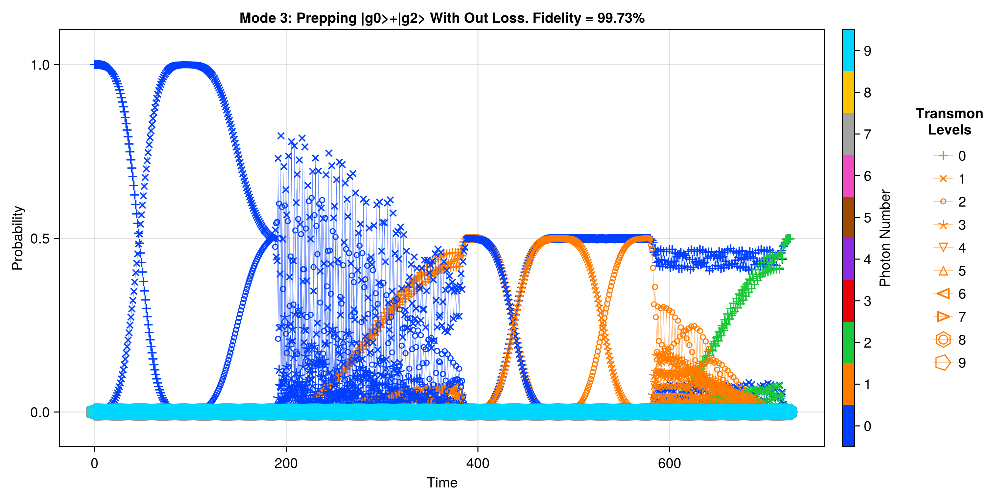

CairoMakie.Screen{IMAGE}


In [158]:
n = 2
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p2_res["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p2_res["times"], EVs_0p2, axis_kwargs = axis_kwargs, plot_every = 5)

In [159]:
real(qt.expect(op, prep_0p2_res["states"][end]))

0.9973321662818667

#### Looking at With Loss

In [127]:
prep_0p2_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_2_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [128]:
EVs_0p2_loss = SC.Utils.Get_EVs(prep_0p2_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 15:56:14] Info: Making Plot


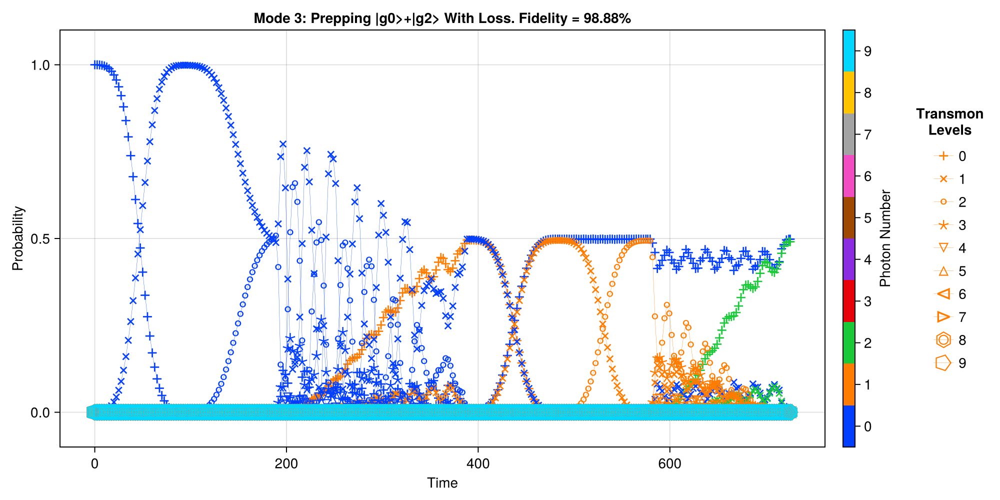

CairoMakie.Screen{IMAGE}


In [156]:
n = 2
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p2_loss["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p2_loss["times"], EVs_0p2_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [157]:
real(qt.expect(op, prep_0p2_loss["states"][end]))

0.9888161607638664

#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [211]:
prep_0p2_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_2_Wed-Nov-13-24_18_27.nc")
prep_0p2_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_2_upper_Thu-Nov-14-24_18_12.nc")
prep_0p2_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_2_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:06
Progress: 100%|█████████████████████████████████████████| Time: 0:00:03
Progress: 100%|█████████████████████████████████████████| Time: 0:00:03


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [212]:
EVs_0p2_loss = SC.Utils.Get_EVs(prep_0p2_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p2_loss_upper = SC.Utils.Get_EVs(prep_0p2_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p2_loss_lower = SC.Utils.Get_EVs(prep_0p2_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9888161607638664
[2024-11-15 17:43:25] Info: Making Plot
Fidelity: 0.9824977114687165
[2024-11-15 17:43:27] Info: Making Plot
Fidelity: 0.9743231568831181
[2024-11-15 17:43:29] Info: Making Plot


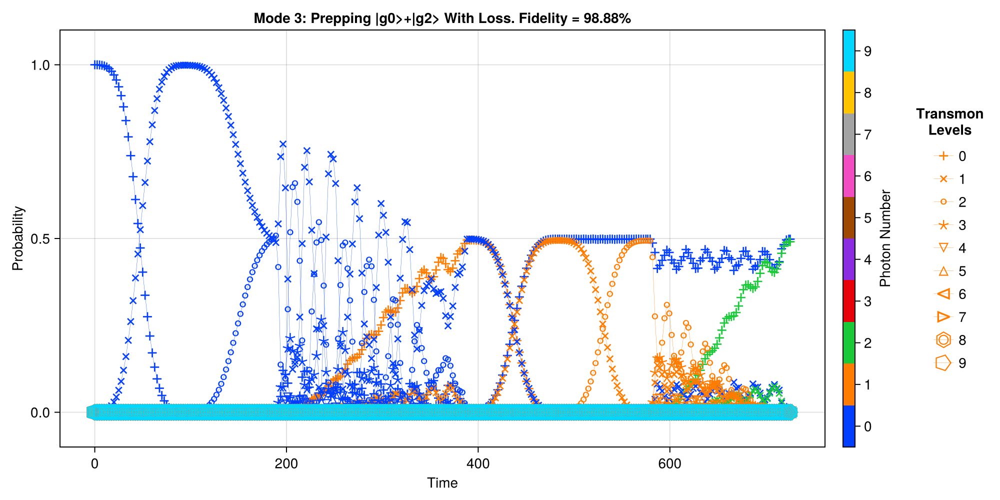

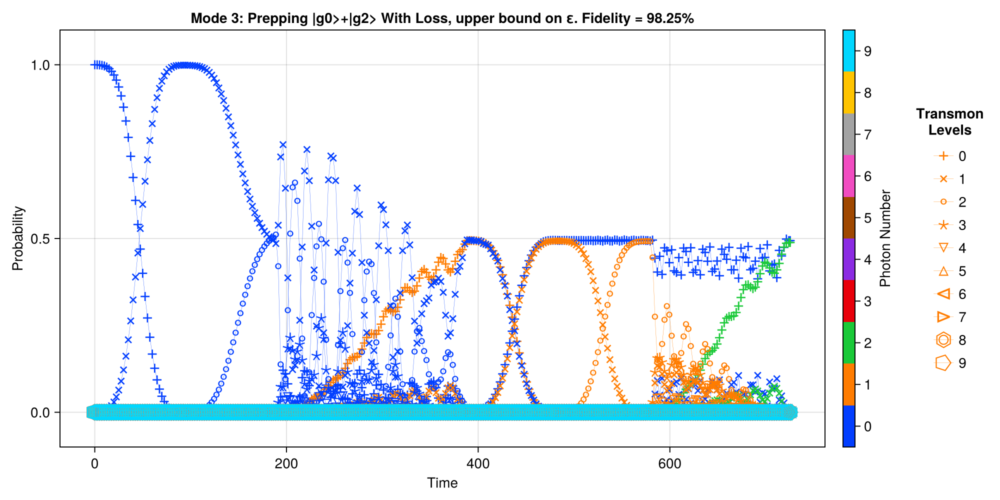

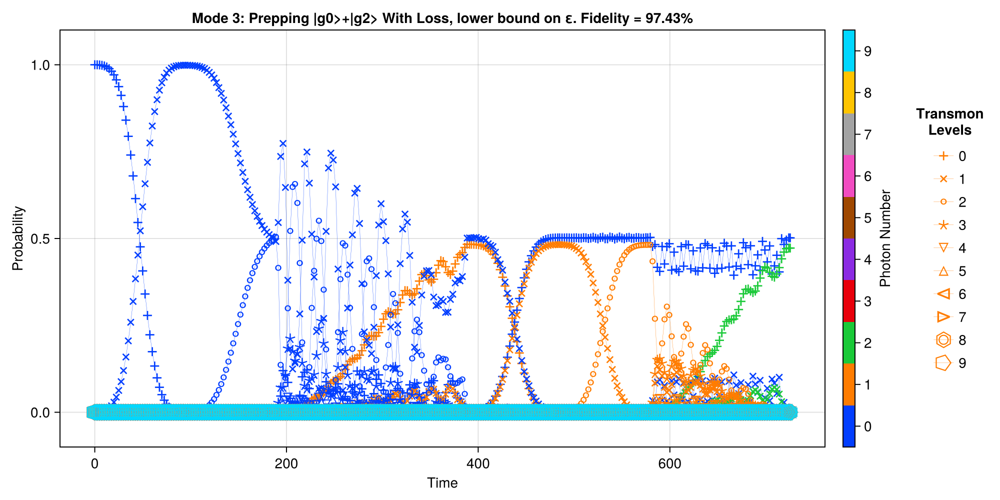

CairoMakie.Screen{IMAGE}


In [215]:
n = 2
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'

fid = real(qt.expect(op, prep_0p2_loss["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p2_loss["times"], EVs_0p2_loss, axis_kwargs = axis_kwargs, plot_every = 5)


fid = real(qt.expect(op, prep_0p2_loss_upper["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p2_loss_upper["times"], EVs_0p2_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(qt.expect(op, prep_0p2_loss_lower["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p2_loss_lower["times"], EVs_0p2_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|0\rangle+|3\rangle$ 

#### Running No Loss

In [130]:
ψ = Mode3.dressed_states[(0,0)]

prep_0p3_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_0_+_3"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.15.3
It is being saved at: Data/
[2024-11-14 15:03:59] Info: Running operator q_ge_0
[2024-11-14 15:03:59] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 15:04:01] Info: Time Evolution Complete
[2024-11-14 15:04:01] Info: Saving Steps
[2024-11-14 15:04:03] Info: Done with Step_1
[2024-11-14 15:04:03] Info: Running operator q_half_ef0
[2024-11-14 15:04:03] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 15:04:05] Info: Time Evolution Complete
[2024-11-14 15:04:05] Info: Saving Steps
[2024-11-14 15:04:06] Info: Done with Step_2
[2024-11-14 15:04:06] Info: Running operator sb_f0g1
[2024-11-14 15:04:06] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 05s (ETA: 0h 00m 00s)
[2024-11-14 15:04:12] Info: 

Progress: 100%|█████████████████████████████████████████| Time: 0:00:01


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [131]:
EVs_0p3 = SC.Utils.Get_EVs(prep_0p3_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 16:29:58] Info: Making Plot


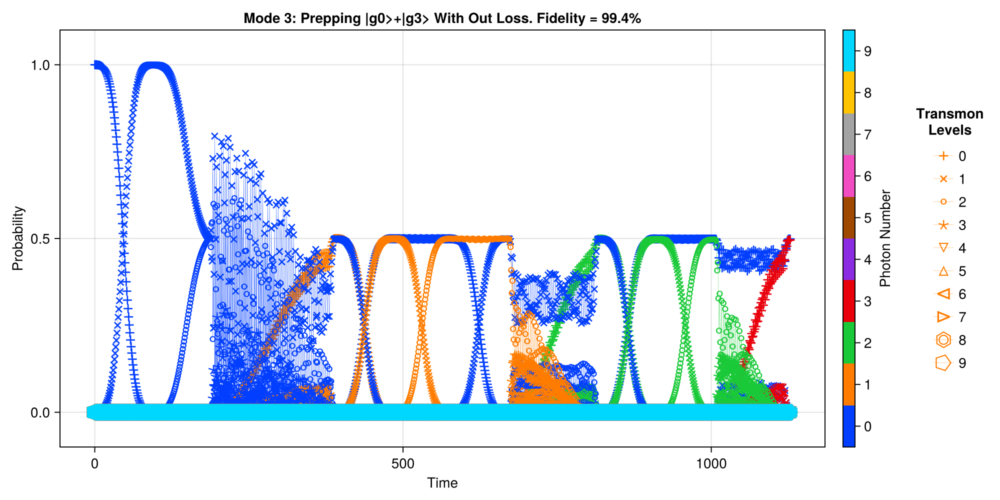

CairoMakie.Screen{IMAGE}


In [160]:
n = 3
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p3_res["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p3_res["times"], EVs_0p3, axis_kwargs = axis_kwargs, plot_every = 5)

In [161]:
real(qt.expect(op, prep_0p3_res["states"][end]))

0.9940313558994113

#### Looking at With Loss

In [133]:
prep_0p3_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_3_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [134]:
EVs_0p3_loss = SC.Utils.Get_EVs(prep_0p3_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 16:30:19] Info: Making Plot


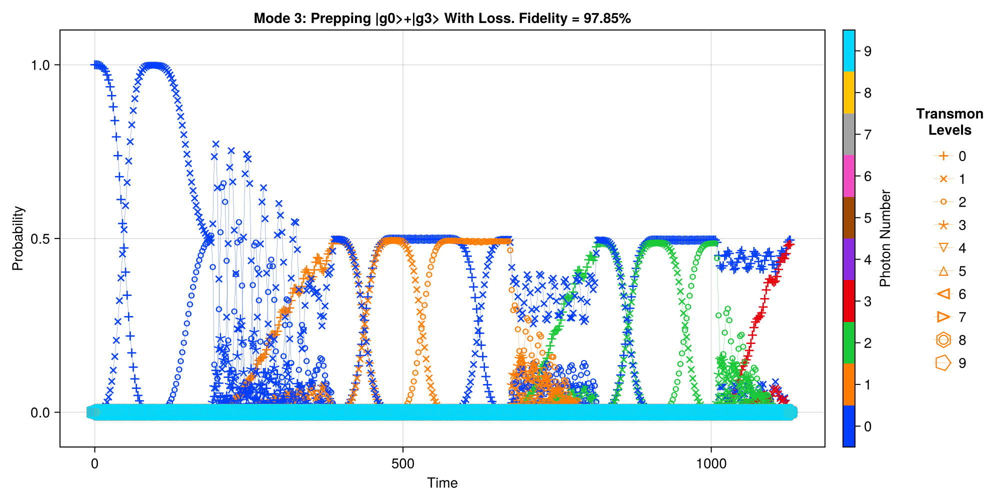

CairoMakie.Screen{IMAGE}


In [162]:
n = 3
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p3_loss["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p3_loss["times"], EVs_0p3_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [163]:
real(qt.expect(op, prep_0p3_loss["states"][end]))

0.9784815213045346

#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [216]:
prep_0p3_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_3_Wed-Nov-13-24_18_27.nc")
prep_0p3_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_3_upper_Thu-Nov-14-24_18_12.nc")
prep_0p3_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_3_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:04
Progress: 100%|█████████████████████████████████████████| Time: 0:00:04
Progress: 100%|█████████████████████████████████████████| Time: 0:00:05


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [217]:
EVs_0p3_loss = SC.Utils.Get_EVs(prep_0p3_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p3_loss_upper = SC.Utils.Get_EVs(prep_0p3_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p3_loss_lower = SC.Utils.Get_EVs(prep_0p3_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9784815213045346
[2024-11-15 17:45:31] Info: Making Plot
Fidelity: 0.9749492982761807
[2024-11-15 17:45:34] Info: Making Plot
Fidelity: 0.9591322542207114
[2024-11-15 17:45:37] Info: Making Plot


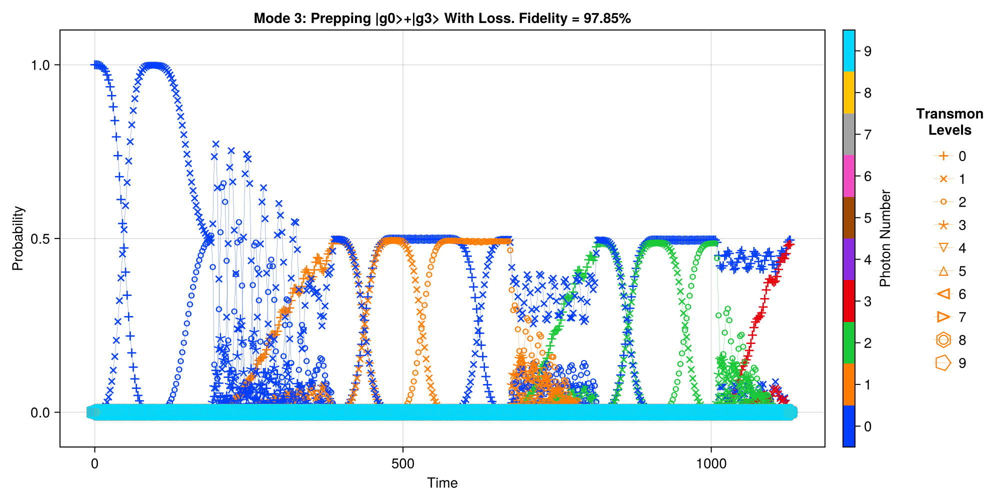

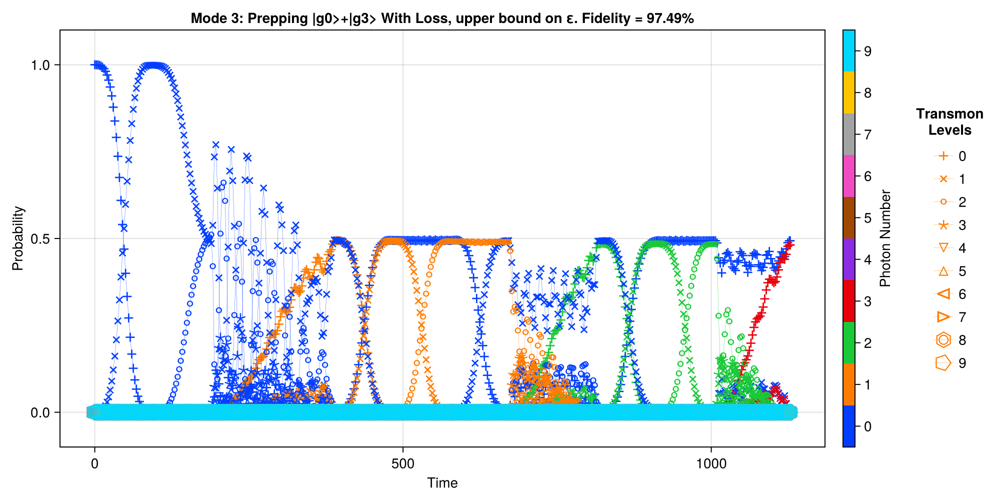

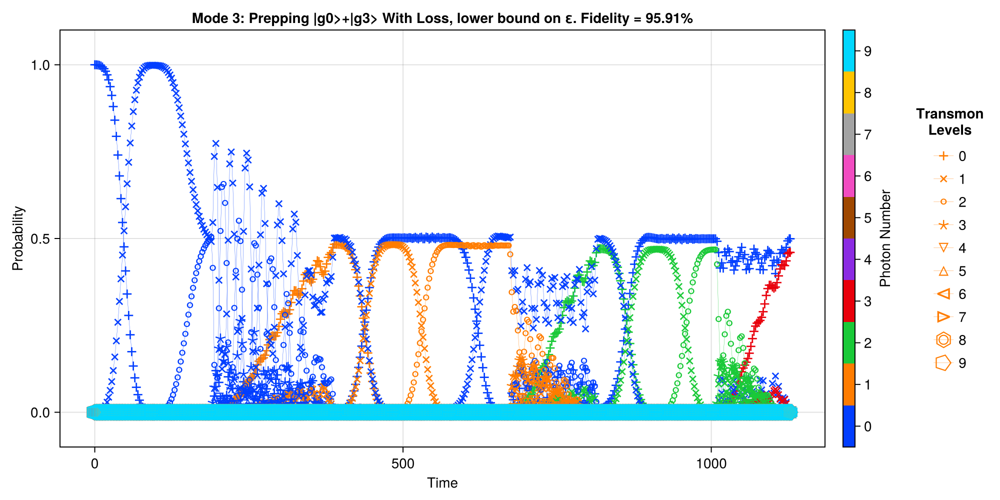

CairoMakie.Screen{IMAGE}


In [218]:
n = 3
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'

fid = real(qt.expect(op, prep_0p3_loss["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p3_loss["times"], EVs_0p3_loss, axis_kwargs = axis_kwargs, plot_every = 5)


fid = real(qt.expect(op, prep_0p3_loss_upper["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p3_loss_upper["times"], EVs_0p3_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(qt.expect(op, prep_0p3_loss_lower["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p3_loss_lower["times"], EVs_0p3_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


### $|0\rangle+|4\rangle$ 

#### Running No Loss

In [136]:
ψ = Mode3.dressed_states[(0,0)]

prep_0p4_res = SC.Dynamics.RunPulseSequence(Mode3, ψ, Mode3.Stuff["Drive_Sequences"]["Prep_0_+_4"])

The Name for this run is: Operator_Sequence_Thu-Nov-14-24.15.5
It is being saved at: Data/
[2024-11-14 15:05:51] Info: Running operator q_ge_0
[2024-11-14 15:05:51] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)
[2024-11-14 15:05:53] Info: Time Evolution Complete
[2024-11-14 15:05:53] Info: Saving Steps
[2024-11-14 15:05:54] Info: Done with Step_1
[2024-11-14 15:05:54] Info: Running operator q_half_ef0
[2024-11-14 15:05:54] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 01s (ETA: 0h 00m 00s)
[2024-11-14 15:05:56] Info: Time Evolution Complete
[2024-11-14 15:05:56] Info: Saving Steps
[2024-11-14 15:05:58] Info: Done with Step_2
[2024-11-14 15:05:58] Info: Running operator sb_f0g1
[2024-11-14 15:05:58] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 04s (ETA: 0h 00m 00s)
[2024-11-14 15:06:02] Info: 

Progress: 100%|█████████████████████████████████████████| Time: 0:00:02


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.199933, 0.399866, 0.599798, 0.799731, 0.999664, 1.1996…
  "states" => Any[Quantum Object:   type=Ket   dims=[10, 10]   size=(100,)…

#### Making Plot

In [137]:
EVs_0p4 = SC.Utils.Get_EVs(prep_0p4_res["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 16:30:40] Info: Making Plot


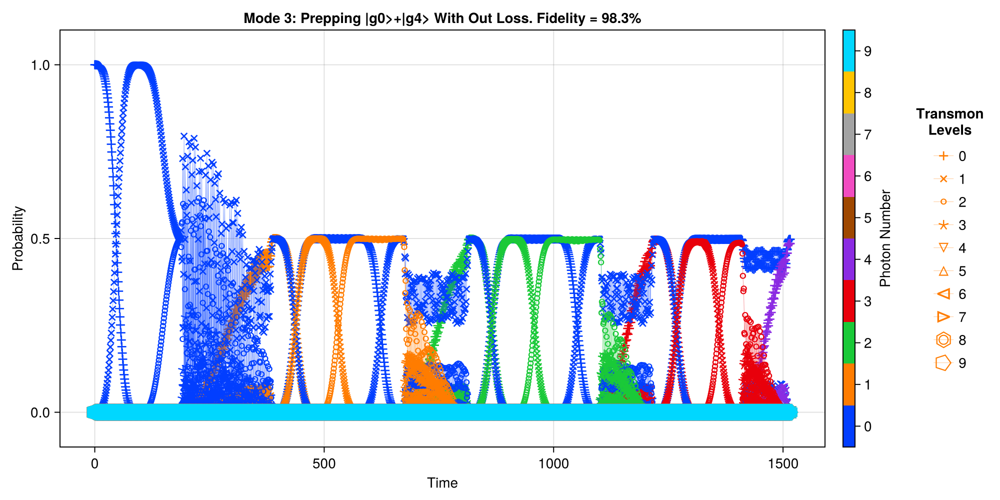

CairoMakie.Screen{IMAGE}


In [164]:
n = 4
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p4_res["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Out Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p4_res["times"], EVs_0p4, axis_kwargs = axis_kwargs, plot_every = 5)

In [166]:
real(qt.expect(op, prep_0p4_res["states"][end]))

0.9830293123564562

#### Looking at With Loss

In [139]:
prep_0p4_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_4_Wed-Nov-13-24_18_27.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:04


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [140]:
EVs_0p4_loss = SC.Utils.Get_EVs(prep_0p4_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

[2024-11-14 17:25:48] Info: Making Plot


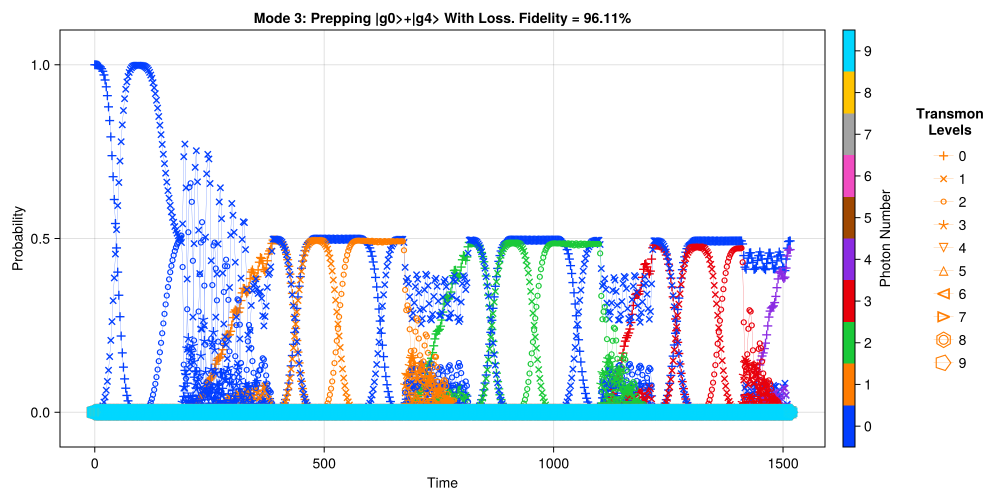

CairoMakie.Screen{IMAGE}


In [167]:
n = 4
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'
fid = round(real(qt.expect(op, prep_0p4_loss["states"][end]))*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p4_loss["times"], EVs_0p4_loss, axis_kwargs = axis_kwargs, plot_every = 5)

In [168]:
real(qt.expect(op, prep_0p4_loss["states"][end]))

0.9610959511913327

#### Looking At Loss Plus Upper and Lower variation on drive strength


##### Getting Data

In [219]:
prep_0p4_loss = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_4_Wed-Nov-13-24_18_27.nc")
prep_0p4_loss_upper = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_4_upper_Thu-Nov-14-24_18_12.nc")
prep_0p4_loss_lower = SC.Utils.LoadRunResults("Data/Mode3_N_and_0_P_N_Data/Mode3_Prep_0_p_4_lower_Thu-Nov-14-24_18_10.nc")

Progress: 100%|█████████████████████████████████████████| Time: 0:00:06
Progress: 100%|█████████████████████████████████████████| Time: 0:00:06
Progress: 100%|█████████████████████████████████████████| Time: 0:00:06


Dict{Any, Any} with 2 entries:
  "times"  => Any[0.0, 0.499832, 0.999664, 1.4995, 1.99933, 2.49916, 2.99899, 3…
  "states" => Any[Quantum Object:   type=Operator   dims=[10, 10]   size=(100, …

In [220]:
EVs_0p4_loss = SC.Utils.Get_EVs(prep_0p4_loss["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p4_loss_upper = SC.Utils.Get_EVs(prep_0p4_loss_upper["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));
EVs_0p4_loss_lower = SC.Utils.Get_EVs(prep_0p4_loss_lower["states"], SC.Utils.Get_Projection_Ops(Mode3.dressed_states));

##### Plotting Evolutions

Fidelity: 0.9610959511913327
[2024-11-15 17:48:23] Info: Making Plot
Fidelity: 0.9597469117422605
[2024-11-15 17:48:27] Info: Making Plot
Fidelity: 0.9370738933311717
[2024-11-15 17:48:31] Info: Making Plot


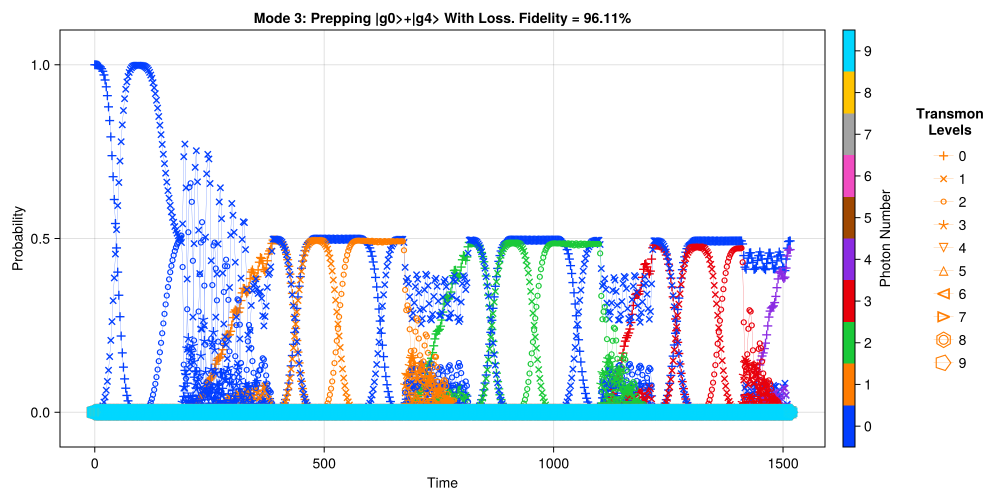

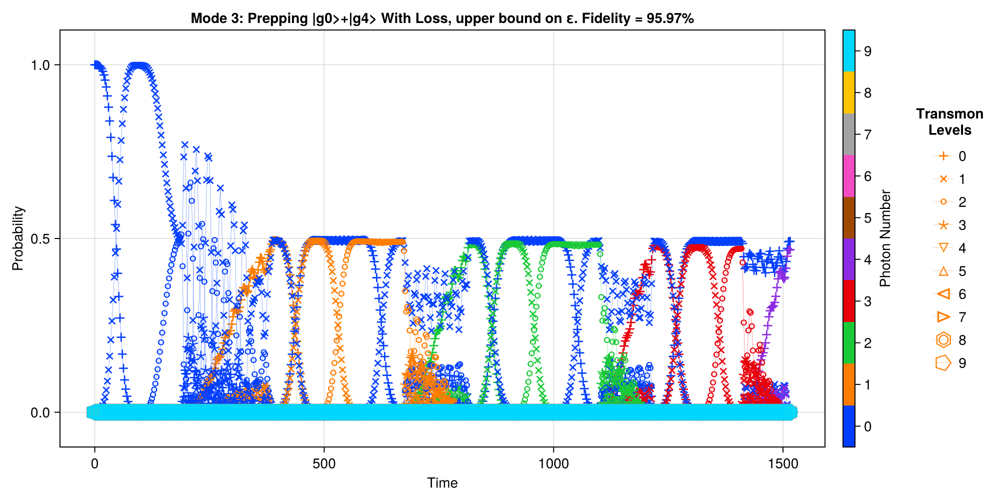

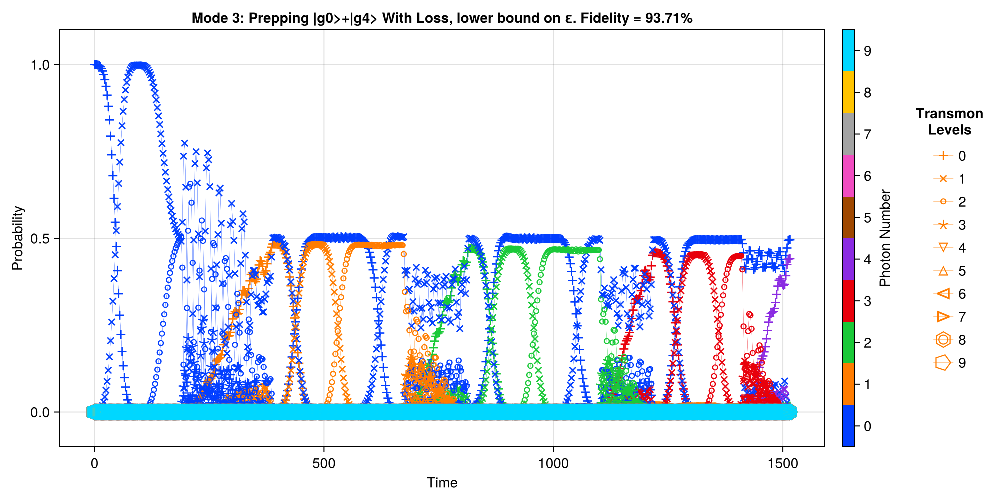

CairoMakie.Screen{IMAGE}


In [221]:
n = 4
ψ0 = Mode3.dressed_states[(0,0)]
ψn = Mode3.dressed_states[(0,n)]
op = ψ0*ψ0'+ψn*ψn'

fid = real(qt.expect(op, prep_0p4_loss["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p4_loss["times"], EVs_0p4_loss, axis_kwargs = axis_kwargs, plot_every = 5)


fid = real(qt.expect(op, prep_0p4_loss_upper["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, upper bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p4_loss_upper["times"], EVs_0p4_loss_upper, axis_kwargs = axis_kwargs, plot_every = 5)

fid = real(qt.expect(op, prep_0p4_loss_lower["states"][end]))
println("Fidelity: $(fid)")
fid = round(fid*100, digits = 2)
axis_kwargs = Dict{Any, Any}("title" => "Mode 3: Prepping |g0>+|g$(n)> With Loss, lower bound on ε. Fidelity = $(fid)%")
SC.Dynamics.PlotSingleModeEvolution(Mode3, prep_0p4_loss_lower["times"], EVs_0p4_loss_lower, axis_kwargs = axis_kwargs, plot_every = 5)


# Plots of Ramp times and shapes

In [6]:
Mode3.Stuff["op_drive_params"]#["f0g1_SS_10.0"]

Dict{String, Any} with 19 entries:
  "q_ef_3"           => Dict{String, Any}("pulse_time"=>93.125, "Envelope Args"…
  "sb_f1g2_2pi_f3g4" => Dict{String, Any}("pulse_time"=>910.084, "Envelope Args…
  "q_half_ge0"       => Dict{String, Any}("pulse_time"=>92.9688, "Envelope Args…
  "q_ef_2"           => Dict{String, Any}("pulse_time"=>92.9688, "Envelope Args…
  "sb_f2g3"          => Dict{String, Any}("pulse_time"=>123.609, "Envelope Args…
  "sb_f0g1_4pi_f3g4" => Dict{String, Any}("pulse_time"=>1492.92, "Envelope Args…
  "q_ge_2"           => Dict{String, Any}("pulse_time"=>92.9688, "Envelope Args…
  "q_ge_1/2"         => Dict{String, Any}("pulse_time"=>92.9688, "Envelope Args…
  "sb_half_f1g2"     => Dict{String, Any}("pulse_time"=>80.4375, "Envelope Args…
  "sb_f1g2"          => Dict{String, Any}("pulse_time"=>148.613, "Envelope Args…
  "q_ge_4/3"         => Dict{String, Any}("pulse_time"=>92.9688, "Envelope Args…
  "q_ge_3"           => Dict{String, Any}("pulse_time"=>92.9688, "Envelope

In [7]:
Ramp_Times = vcat(collect(LinRange(0.001, 20-0.001, 100)),collect(LinRange(20, 100, 80)))
envelopes = ["Sine_Squared_Ramp", "Gaussian_Ramp"]
chirped = [true, false]

res = Dict{Any, Any}()

for envelope in envelopes
    for rt in Ramp_Times
        for chirp in chirped
            drive_name = ""
            if envelope == "Sine_Squared_Ramp"
                drive_name = "f0g1_SS_"*string(rt)
            end
            if envelope == "Gaussian_Ramp"
                drive_name = "f0g1_G_"*string(rt)
            end

            if chirp
                drive_name = drive_name*"_chirped"
            end

            if drive_name in keys(Mode3.Stuff["op_drive_params"])
                res[drive_name] = Mode3.Stuff["op_drive_params"][drive_name]["accuracy"]
            end
        end
    end
end

In [8]:
SS = []
SS_x = []
SS_chirp = []
SS_chirp_x = []

G = []
G_x = []
G_chirp = []
G_chirp_x = []

for key in keys(res)
    key_split = split(key, "_")
    if length(key_split) == 4
        if key_split[2] == "SS"
            push!(SS_chirp, res[key])
            push!(SS_chirp_x, Meta.parse(key_split[3]))
        end
        if key_split[2] == "G"
            push!(G_chirp, res[key])
            push!(G_chirp_x, Meta.parse(key_split[3]))
        end
    else
        if key_split[2] == "SS"
            push!(SS, res[key])
            push!(SS_x, Meta.parse(key_split[3]))
        end
        if key_split[2] == "G"
            push!(G, res[key])
            push!(G_x, Meta.parse(key_split[3]))
        end
    end
end


In [9]:
permvec = sortperm(SS_x)
SS = SS[permvec]
SS_x = sort(SS_x)

permvec = sortperm(SS_chirp_x)
SS_chirp = SS_chirp[permvec]
SS_chirp_x = sort(SS_chirp_x)

permvec = sortperm(G_x)
G = G[permvec]
G_x = sort(G_x)

permvec = sortperm(G_chirp_x)
G_chirp = G_chirp[permvec]
G_chirp_x = sort(G_chirp_x);

In [10]:
SS_chirp_x[argmax(SS_chirp)]

MethodError: MethodError: reducing over an empty collection is not allowed; consider supplying `init` to the reducer

In [11]:
f = cm.Figure(size = (500, 250), px_per_unit = 8)
ax = cm.Axis(f[1,1], title = "Fidelity vs Ramp Time", xlabel = "Ramp Time (ns)", ylabel = "Fidelity")

cm.scatterlines!(ax, SS_x, SS, marker = '×', label = "SS", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, SS_chirp_x, SS_chirp, marker = '□', label = "SS Chirp", linewidth = 0.1)
cm.scatterlines!(ax, G_x, G, marker = '+', label = "G", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, G_chirp_x, G_chirp, marker = '⋄', markersize = 20, label = "G Chirp", linewidth = 0.1)
cm.axislegend(ax, position = :rb)

cm.display(f)


 
f = cm.Figure(size = (500, 250), px_per_unit = 8)
ax = cm.Axis(f[1,1], yscale = cm.log10, title = "Infidelity vs Ramp Time", xlabel = "Ramp Time (ns)", ylabel = "Infidelity")

cm.scatterlines!(ax, SS_x, -(SS.-1), marker = '×', label = "SS", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, SS_chirp_x, -(SS_chirp.-1), marker = '□', label = "SS Chirp", linewidth = 0.1)
cm.scatterlines!(ax, G_x, -(G.-1), marker = '+', label = "G", linewidth = 0.1, markersize = 20)
cm.scatterlines!(ax, G_chirp_x, -(G_chirp.-1), marker = '⋄', markersize = 20, label = "G Chirp", linewidth = 0.1)
cm.axislegend(ax, position = :rt, orientation = :horizontal)

cm.display(f)




MethodError: MethodError: reducing over an empty collection is not allowed; consider supplying `init` to the reducer

# Ramp Time Floquet

In [12]:
m(ε) = sum(Mode3.Stuff["Chirp Params"]["fn_gn+1"][1]["param"][n]*ε^n for n in 1:length(Mode3.Stuff["Chirp Params"]["fn_gn+1"][1]["param"]))
f = cm.Figure(size = (500, 250))
ax = cm.Axis(f[1,1], title = "Stark Shift Fit", xlabel = "Drive Strength", ylabel = "Stark Shift")

x = collect(LinRange(0, 1, 51))
cm.plot!(ax, x, m.(x), label = "fit")
cm.plot!(ax, Mode3.Stuff["Chirp Params"]["fn_gn+1"][2], Mode3.Stuff["Chirp Params"]["fn_gn+1"][3], label = "data")
cm.axislegend(ax, position = :rb)

f

KeyError: KeyError: key "Chirp Params" not found

## Chirped

In [13]:
states_to_track = Dict{Any, Any}();
states_to_track[(0,0)] = Mode3.dressed_states[(0,0)];
states_to_track[(1,0)] = Mode3.dressed_states[(1,0)];
states_to_track[(2,0)] = Mode3.dressed_states[(2,0)];
states_to_track[(3,0)] = Mode3.dressed_states[(3,0)];
#states_to_track[(4,0)] = Mode3.dressed_states[(4,0)];
states_to_track[(0,1)] = Mode3.dressed_states[(0,1)];
states_to_track[(1,1)] = Mode3.dressed_states[(1,1)];
#states_to_track[(2,1)] = Mode3.dressed_states[(2,1)];
#states_to_track[(3,1)] = Mode3.dressed_states[(3,1)];
#states_to_track[(0,2)] = Mode3.dressed_states[(0,2)];
#states_to_track[(1,2)] = Mode3.dressed_states[(1,2)];
#states_to_track[(2,2)] = Mode3.dressed_states[(2,2)];
states_to_track = copy(Mode3.dressed_states);#Dict{Any, Any}();

In [14]:
for key in keys(Mode3.Stuff["op_drive_params"])
    println(key)
end 

q_ef_3
sb_f1g2_2pi_f3g4
q_half_ge0
q_ef_2
sb_f2g3
sb_f0g1_4pi_f3g4
q_ge_2
q_ge_1/2
sb_half_f1g2
sb_f1g2
q_ge_4/3
q_ge_3
q_ef_0
q_ge_0
q_ge_1
sb_f3g4
q_ef_1
sb_f0g1
q_ef_3/2


In [26]:
op_name = "sb_f0g1"#"f0g1_SS_16.767_chirped" #"f0g1_SS_70.63291139240506_chirped"
pulse = copy(Mode3.Stuff["op_drive_params"][op_name])

#pulse["pulse_time"] = 10
envelope_args = Dict{Symbol, Any}()
for key in keys(Mode3.Stuff["op_drive_params"][op_name]["Envelope Args"])
    envelope_args[Symbol(key)] = Mode3.Stuff["op_drive_params"][op_name]["Envelope Args"][key]
end

pt = pulse["pulse_time"]
rt = pulse["Envelope Args"]["ramp_time"]
ft = pt-2*rt 


ε0 = pulse["epsilon"]
ν0 = pulse["freq_d"]


εt(t) = ε0*SC.Dynamics.Envelopes.Envelope_Dict[pulse["Envelope"]](t; envelope_args...)



νε(ε) = ν0+pulse["shift"]
if "chirp_params" in keys(pulse)
    νε(ε) = SC.Dynamics.chirper(ν0, pulse["chirp_params"])(ε)
end

νft = νε(ε0) 
Tft = abs(1/νft)
T0 = abs(1/ν0)

Tr =1*Tft


times_to_sample = collect(LinRange(0.0, pt, 500000))

ev = SC.Dynamics.Envelopes.Get_Envelope(pulse["Envelope"], pulse["Envelope Args"])
ϕ = SC.Dynamics.Get_Drive_Coef(νε, ε0, envelope = ev, return_ϕ = true, drive_time = pt)#pulse["pulse_time"]);
f_for_peak(t) = -abs.(sin.(ϕ.(t)))
for_peaks = f_for_peak.(times_to_sample)
indices, heights = Peaks.findmaxima(for_peaks)

times = vcat([0], times_to_sample[indices][2:2:end], [pt])

strob_times = SC.Dynamics.Get_Stroboscopic_Times(pulse)

ψ = Mode3.dressed_states[(2,0)]



solver_kwargs = Dict{Any, Any}("abstol" => 1e-8, "reltol" => 1e-8)
pulse_res = SC.Dynamics.RunSingleOperator(Mode3, ψ, pulse, spns = 10, solver_kwargs = solver_kwargs, tspan = times)



[2024-11-12 16:48:06] Info: Running Time Evolution
Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 08s (ETA: 0h 00m 00s)
[2024-11-12 16:48:17] Info: Time Evolution Complete
[2024-11-12 16:48:17] Info: Done with DEFAULT


Solution of time evolution
(return code: Success)
--------------------------
num_states = 582
num_expect = 0
ODE alg.: Vern9{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false), true)
abstol = 1.0e-8
reltol = 1.0e-8


In [27]:
list_of_params = []

for t in pulse_res.times
    ε = εt(t)
    ν = νε(ε)
    dict_to_append = Dict{Any, Any}("ε" => ε, "ν" => ν)#, "t0" => t)
    push!(list_of_params, dict_to_append)
end

floq_sweep_res = SC.Dynamics.Floquet_t0_Sweep(Mode3, list_of_params, states_to_track = states_to_track);

println("hi") 



[2024-11-12 16:48:18] Info: Beginning Floquet Sweep


Progress: 100%|█████████████████████████████████████████| Time: 0:00:50


[2024-11-12 16:49:09] Info: Done With Floquet Sweep
[2024-11-12 16:49:09] Info: Tracking State


Progress:  16%|██████▋                                  |  ETA: 0:00:06

[2024-11-12 16:49:10] Info: Running the necessary time evolutions
hi


In [28]:
projections = Dict{Any, Any}()


for state in keys(states_to_track)
    projections[state] = []
    for i in 1:length(pulse_res.times)
        t = pulse_res.times[i]
        ε = εt(t)
        #idx = findall(x -> x == ε, epsilons_to_sample)
        Φ = floq_sweep_res[State = At(string(state)), Step = At(i)]["ψ"]
        push!(projections[state], abs(pulse_res.states[i]'*Φ)^2)
    end
end

[2024-11-12 17:00:54] Info: Making Plot


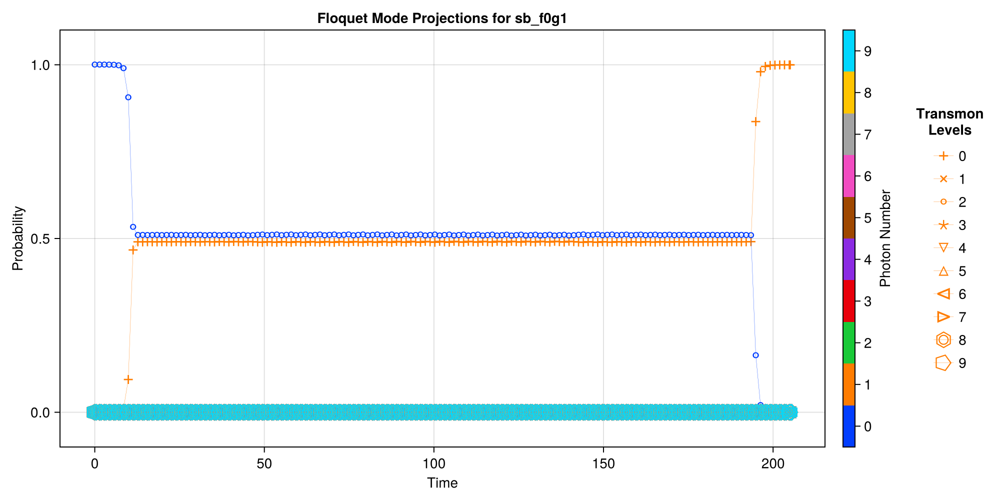

CairoMakie.Screen{IMAGE}


In [33]:
axis_kwargs = Dict{Any, Any}("title" => "Floquet Mode Projections for "*op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, pulse_res.times, projections, axis_kwargs = axis_kwargs, plot_every = 4)

[2024-11-12 16:59:52] Info: Making Plot


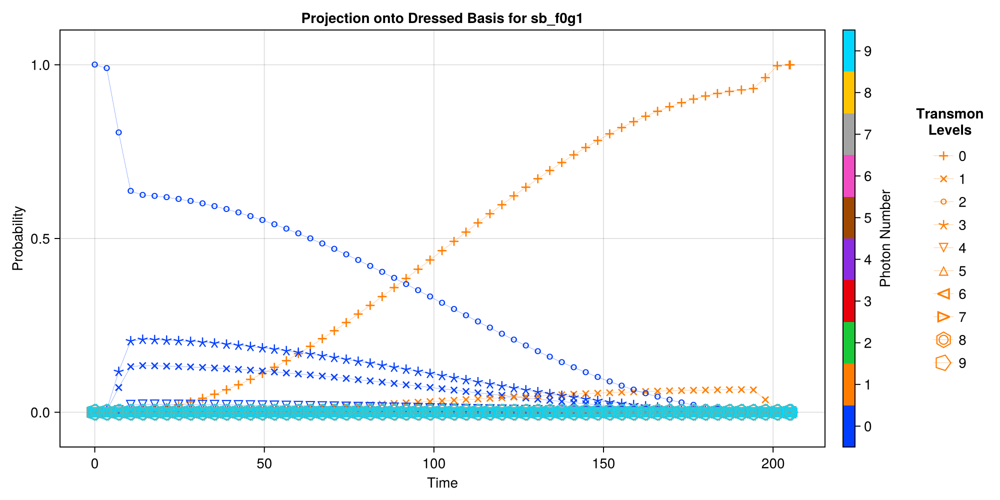

CairoMakie.Screen{IMAGE}


In [31]:
axis_kwargs = Dict{Any, Any}("title" => "Projection onto Dressed Basis for "*op_name)
SC.Dynamics.PlotSingleModeEvolution(Mode3, pulse_res.times, pulse_res.states, axis_kwargs = axis_kwargs, plot_every = 10)

# Playing with propagtors

In [ ]:
H = Mode3.Ĥ
T = abs(1/νft)
drive_coef = SC.Dynamics.Get_Drive_Coef(νft, ε0)
Ĥ_D = SC.Dynamics.Get_Ĥ_D(Mode3.n̂ₜ, drive_coef, TDOS = false)

function func(u, p, t)
    return -1im*(2*π*H.data-Ĥ_D(t).data)*u
end

u0 = Matrix(qt.qeye(prod(H.dims), dims = H.dims).data)

tspan = [0.0, T]

prob = ODEProblem(func, u0, tspan)

U = solve(prob, Vern9())#, reltol = 1e-9, abstol= 1e-9)

In [ ]:
H = Mode3.Ĥ
drive_coef = SC.Dynamics.Get_Drive_Coef(νft, ε0)
Ĥ_D_TDOS = SC.Dynamics.Get_Ĥ_D(Mode3.n̂ₜ, drive_coef)
U2 = SC.Dynamics.Propagator(Mode3, Ĥ_D_TDOS, T)

In [8]:
floq_SC = SC.Dynamics.Get_Floquet_t0_Eigsys(Mode3, Ĥ_D_TDOS, T);

In [ ]:
sort(floq_SC[1])

In [ ]:
U_eigs = eigen(U(T))

sort(-angle.(U_eigs.values)/T)

In [ ]:
function lorenz!(du,u,p,t)
    du[1] = 10.0(u[2]-u[1])
    du[2] = u[1]*(28.0-u[3]) - u[2]
    du[3] = u[1]*u[2] - (8/3)*u[3]
   end
   u0 = [1.0;0.0;0.0]
   tspan = (0.0,100.0)
   prob = ODEProblem(lorenz!,u0,tspan)
   
   
   sol = solve(prob,Tsit5())
   using Plots; plot(sol,vars=(1,2,3))

In [82]:
drive_args = copy(Mode3.Stuff["op_drive_params"]["sb_f0g1"])
drive_args["pulse_time"] = 2*drive_args["Envelope Args"]["ramp_time"];
drive_args["Envelope Args"]["pulse_time"] = drive_args["pulse_time"];

In [83]:
run_res = SC.Dynamics.RunSingleOperator(Mode3, ψ, drive_args)

┌ Info: Running Time Evolution
└ @ SuperconductingCavities.Dynamics /local/gr400/Git Repositories/SuperconductingCavities/src/Dynamics/RunOperatorSequence.jl:106


Progress: [==============================] 100.0% --- Elapsed Time: 0h 00m 02s (ETA: 0h 00m 00s)


┌ Info: Time Evolution Complete
└ @ SuperconductingCavities.Dynamics /local/gr400/Git Repositories/SuperconductingCavities/src/Dynamics/RunOperatorSequence.jl:111
┌ Info: Done with DEFAULT
└ @ SuperconductingCavities.Dynamics /local/gr400/Git Repositories/SuperconductingCavities/src/Dynamics/RunOperatorSequence.jl:139


Solution of time evolution
(return code: Success)
--------------------------
num_states = 76
num_expect = 0
ODE alg.: Vern9{typeof(OrdinaryDiffEqCore.trivial_limiter!), typeof(OrdinaryDiffEqCore.trivial_limiter!), Static.False}(OrdinaryDiffEqCore.trivial_limiter!, OrdinaryDiffEqCore.trivial_limiter!, static(false), true)
abstol = 1.0e-6
reltol = 1.0e-6


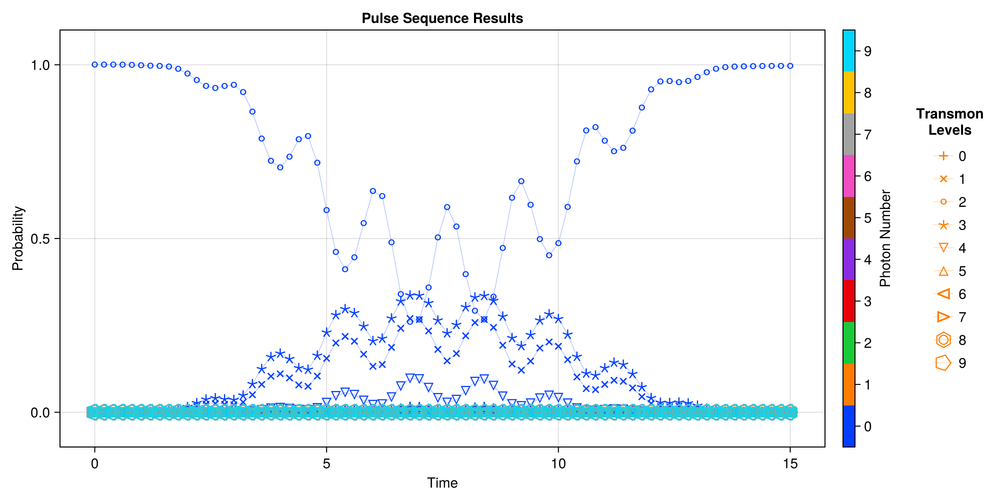

┌ Info: Making Plot
└ @ SuperconductingCavities.Dynamics /local/gr400/Git Repositories/SuperconductingCavities/src/Dynamics/PlotStateEvolution.jl:68


CairoMakie.Screen{IMAGE}


In [84]:
SC.Dynamics.PlotSingleModeEvolution(Mode3, run_res.times, run_res.states)

In [92]:
abs(run_res.states[end]'*Mode3.dressed_states[(0,1)])^2

0.0037870843052420057